In [1]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt
import time
import json

In [2]:
IMG_SRC = "../images/"
DEFAULT_STYLE = "bmh"
plt.style.use(DEFAULT_STYLE)

# Helper Functions
* These functions will be used throughout the notebook in various questions and are hence defined here

In [3]:
def show_dict(inp):
    print(json.dumps(inp, indent=4))

In [4]:
def imshow(img, col_map="gray", ax = None, figsize=(10,10)):
    
    if ax == None:
        fig = plt.figure(figsize=figsize)
    
    if col_map == "gray":
        if ax:
            ax.imshow(img, cmap=col_map)
        else:
            plt.imshow(img, cmap=col_map)
    else:
        if ax:
            ax.imshow(img)
        else:
            plt.imshow(img)
    if ax:
        ax.grid(b=False)
    else:
        plt.grid(b=False)
        

In [5]:
def combine(img_list, mode):
    
    if mode:
        final = (img_list[0]*0).astype('float32')
        for img in img_list:
            img = img.astype('float32')
            final += img**2
        final = np.sqrt(final)
        
        final = final*255/final.max()
        
        return np.clip(final, 0, 255).astype('uint8')
    
    final = img_list[0].astype('float32')
    for img in img_list[1:]:
        final += img.astype('float32')
    
    mn = np.min(final)
    
    final /= np.max(final)
    final *= 255
    return final.astype('uint8')
        

In [1]:
def pad_image(img, k):
    
    h,w = img.shape
    img_padded = np.zeros((h + (k//2)*2, w + (k//2)*2)).astype('float32')
    h_new, w_new = img_padded.shape
    
    img_padded[k//2:h_new-k//2,k//2:w_new-k//2] = img
    
    return img_padded, h_new, w_new

In [7]:
def conv(img, kernel, absolute=False):
    k = kernel.shape[0]
    
    h,w = img.shape
    img_padded, h_new, w_new = pad_image(img, k)
    
    md = int(k*k/2)
    res = np.zeros((h,w)).astype('float32')
    
    for i in range(h):
        for j in range(w):
            res[i,j] = np.sum((img_padded[i:i+k,j:j+k]*kernel).ravel())
    
    if absolute:
        res = np.abs(res)
        
    res = np.clip(res, 0, 255)
    return res.astype('uint8')

# Q1)

## 1.1: Unoptimized Mean Filter

* This filter works by first padding the image based on the value of $k$
* For each pixel in the input image, we calculate the average value of the elements in a $kxk$ window centered at the current pixel 
* After doing this for the pixels in the input image, we create a new image with the values that we calculated for each pixel
* The complexity of this code is $O(MNk^2)$

In [8]:
def mean_filter_default(img, k):

    h,w = img.shape
    res = np.zeros((h,w))
    
    img = img.astype('float32')
    img_padded, h_new, w_new = pad_image(img, k)
    
    for i in range(h):
        for j in range(w):
            for m in range(k):
                for n in range(k):
                    res[i,j] += img_padded[i+m][j+n]
            res[i,j]/=(k**2)

    return res.astype('uint8')

### Testing the Unoptimized Mean Filter

Text(0.5, 1.0, 'Bell: Unoptimized Mean Filter')

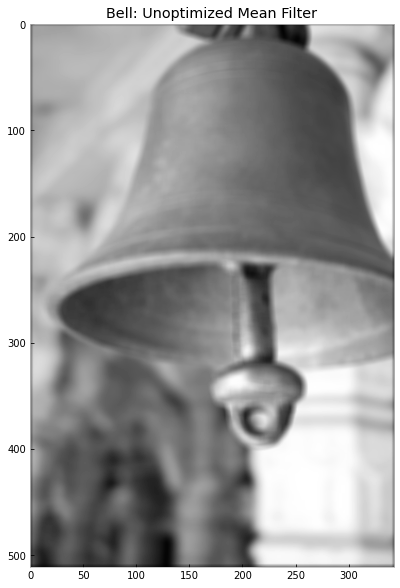

In [9]:
bell = cv.imread(IMG_SRC+"bell.jpg",0)

res_mean_default = mean_filter_default(bell, 7)
imshow(res_mean_default)
plt.title("Bell: Unoptimized Mean Filter")

<hr>

## 1.2: Optimized Mean Filter
* This function optimizes on the previously written function by using *DP* to store the sum of all the elements that are above and to the left of the current pixel, ie. \
    $DP[x,y] = \sum_{i=0}^{x}\sum_{j=0}^{y}f[i,j]$
* At every pixel we can simply calculate this as: \
    $DP[x,y] = DP[x-1,y] + DP[x,y-1] - DP[x-1,y-1]$
* Now we are able to get the average of elements in the $kxk$ window with the current pixel at the center in $O(1)$ time
* This reduces the complexity of the code to $O(MN)$

### Alternative Approach
* Another way to optimize the naïve method would be to use a sliding window approach, but experimentally it was found that the above approach runs much faster

In [10]:
def mean_filter_optimized(img, k):
    
    h,w = img.shape
    
    img = img.astype('float32')
    img_padded, h_new, w_new = pad_image(img, k)
    
    table = [[0 for j in range(w_new)] for i in range(h_new)]
    
    for i in range(h_new):
        for j in range(w_new):
            if j > 0:
                table[i][j] += table[i][j-1]
            if i > 0:
                table[i][j] += table[i-1][j]
            if i > 0 and j > 0:
                table[i][j] -= table[i-1][j-1]
            table[i][j] += img_padded[i,j]
    
    res = np.zeros((h,w)).astype('float32')
    for i in range(h):
        for j in range(w):            
            res[i][j] = table[i+k-1][j+k-1]
            if i > 0 and j > 0:
                res[i][j] += table[i-1][j-1]
            if i > 0:
                res[i][j] -= table[i-1][j+k-1]
            if j > 0:
                res[i][j] -= table[i+k-1][j-1]
    res /= (k**2)
    
    return res.astype('uint8')

### Testing the Optimized Mean Filter

Text(0.5, 1.0, 'Bell: Optimized Mean Filter')

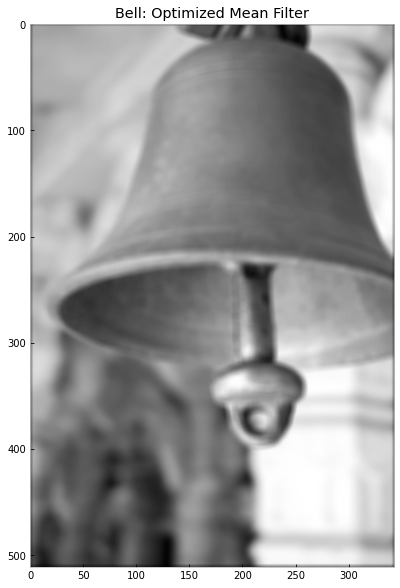

In [11]:
bell = cv.imread(IMG_SRC+"bell.jpg",0)

res_mean_optimized = mean_filter_optimized(bell, 7)
imshow(res_mean_optimized)
plt.title("Bell: Optimized Mean Filter")

<hr>

## 1.3: $k$ vs runtime for Optimized and Unoptimized Mean Filter

* The runtimes were plotted for image sizes: $64x64, 128x128, 256x256, 512x512$ and $k = 3, 5, 7, 9$

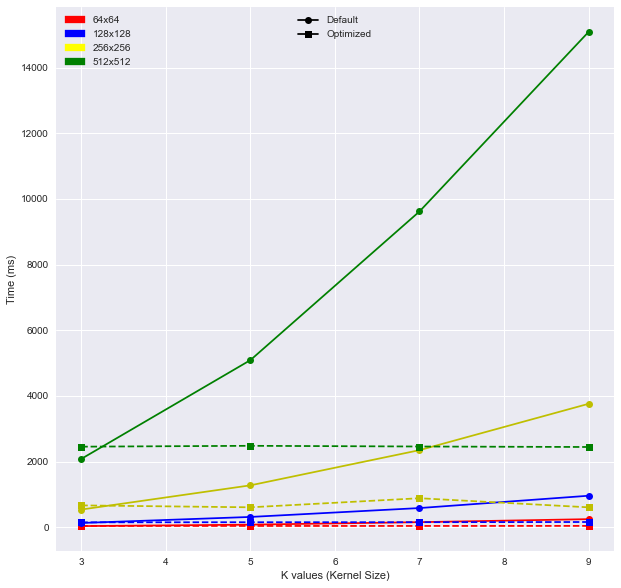

In [12]:
noisy = cv.imread(IMG_SRC+"noisy.jpg",0)

img_size = [64,128,256,512]
n_images = len(img_size)
cols = ['r', 'b', 'y', 'g']
plots = []

times_mean = {}

plt.style.use('seaborn')
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111)

for i in range(n_images):
    csize = img_size[i]
    img = np.resize(noisy, (csize,csize))
    times_mean[csize] = {}
    kvals = [3,5,7,9]
    curr_optim = []
    curr_defal = []
    for k in kvals:

        times_mean[csize][k] = {}
        s = time.time()
        mean_filter_default(img, k)
        ctime = (time.time()-s)*1000
        curr_defal += [ctime]
        times_mean[csize][k]["Unoptimized"] = ctime

        s = time.time()
        mean_filter_optimized(img, k)
        ctime = (time.time()-s)*1000
        curr_optim += [ctime]
        times_mean[csize][k]["Optimized"] = ctime

    plots += plt.plot(kvals, curr_defal, cols[i]+'-', marker='o', label = str(csize)+"x"+str(csize))
    plots += plt.plot(kvals, curr_optim, cols[i]+'--', marker='s', label = str(csize)+"x"+str(csize))
    plt.ylabel("Time (ms)")
    plt.xlabel("K values (Kernel Size)")

from matplotlib.lines import Line2D
from matplotlib.patches import Patch

l1_elements = [
    Patch(facecolor='red', edgecolor='red', label='64x64'),
    Patch(facecolor='blue', edgecolor='blue', label='128x128'),
    Patch(facecolor='yellow', edgecolor='yellow', label='256x256'),
    Patch(facecolor='green', edgecolor='green', label='512x512')
]
l2_elements = [
    Line2D([0], [0], marker='o', color='black', label='Default'),
    Line2D([0], [0], marker='s', color='black', label='Optimized')
]

l1 = plt.legend(handles=l1_elements[:n_images], loc="upper left")
l2 = plt.legend(handles=l2_elements, loc="upper center")
ax.add_artist(l1)

# resetting style
plt.style.use(DEFAULT_STYLE)

* The above plot shows the time taken for the optimized and the unoptimized functions to run for each value of **$k$** and **image size** taken

### Printing the Time Taken 

In [13]:
print("Time Taken by Mean Filter")
show_dict(times_mean)

Time Taken by Mean Filter
{
    "64": {
        "3": {
            "Unoptimized": 34.013986587524414,
            "Optimized": 39.587974548339844
        },
        "5": {
            "Unoptimized": 77.9259204864502,
            "Optimized": 38.545846939086914
        },
        "7": {
            "Unoptimized": 153.81693840026855,
            "Optimized": 38.40994834899902
        },
        "9": {
            "Unoptimized": 245.6059455871582,
            "Optimized": 40.25697708129883
        }
    },
    "128": {
        "3": {
            "Unoptimized": 128.62801551818848,
            "Optimized": 148.5428810119629
        },
        "5": {
            "Unoptimized": 312.6070499420166,
            "Optimized": 151.84879302978516
        },
        "7": {
            "Unoptimized": 583.3237171173096,
            "Optimized": 152.5888442993164
        },
        "9": {
            "Unoptimized": 958.5170745849609,
            "Optimized": 158.35809707641602
        }
    },
    "256"

<hr>

## 1.4: Median Filter

### Unoptimized Median Filter

* This filter works by first padding the image based on the value of $k$
* For each pixel in the input image, we calculate the median value of the elements in a $kxk$ window centered at the current pixel 
* After doing this for the pixels in the input image, we create a new image with the values that we calculated for each pixel
* The complexity of this code is $O(MNk^2)$

In [14]:
def median_filter_default(img, k):
    
    h,w = img.shape
    
    img = img.astype('float32')
    img_padded, h_new, w_new = pad_image(img, k)
    
    md = int((k*k)/2)
    res = np.zeros((h,w)).astype('float32')
    
    for i in range(h):
        for j in range(w):
            
            curr_list = []
            for p in range(k):
                for q in range(k):
                    curr_list += [img_padded[i+p, j+q]]
            
            curr_list.sort()
            res[i,j] = curr_list[md]
            
    return res

### Optimized Mean Filter

* We notice a redundancy in the previous algorithm as it repeatedly goes over the same pixel intensities unnecessarily
* To counter this problem, we use a **sliding window** approach to reduce the redundant calculations
* We run a $kxk$ window across the image, and while moving from $im[x,y]$ to $im[x,y+1]$, we simply **remove the k elements** that would no longer be in the new window and **add the k elements** that would be in the new window
* We then calculate the median by sorting the values in our window
* The overall complexity of this code is $O(MNk\log(k))$ ~ $O(MNk)$, when k is small

In [15]:
def median_filter_optimized(img, k):
    
    h,w = img.shape
    
    img = img.astype('float32')
    img_padded, h_new, w_new = pad_image(img, k)
    
    md = int(k*k/2)
    res = np.zeros((h,w)).astype('float32')
    
    for i in range(h):
        
        init = list(np.sort(img_padded[i:i+k, 0:k].ravel()))
        res[i,0] = init[md]
        
        for j in range(1,w):
            rem = img_padded[i:i+k,j-1].ravel()
            add = img_padded[i:i+k,j+k-1].ravel()
            
            for p in rem:
                init.remove(p)
            for p in add:
                init.append(p)
            
            init.sort()
            res[i,j] = init[md]
            
    return res

### $k$ vs runtime for Optimized and Unoptimized Median Filter

* The runtimes were plotted for image sizes: $64x64, 128x128, 256x256, 512x512$ and $k = 3, 5, 7, 9$

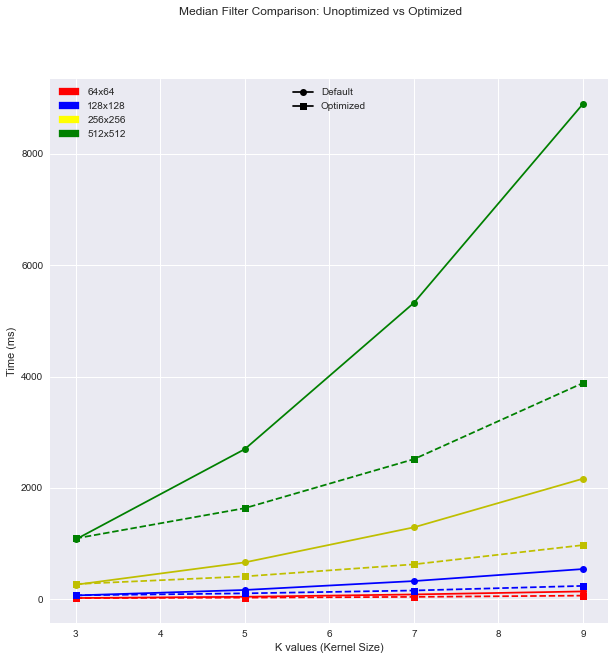

In [16]:
noisy = cv.imread(IMG_SRC+"noisy.jpg",0)

img_size = [64,128,256,512]
n_images = len(img_size)
cols = ['r', 'b', 'y', 'g', 'o']
plots = []

times_median = {}

plt.style.use('seaborn')
fig = plt.figure(figsize=(10,10))

fig.suptitle("Median Filter Comparison: Unoptimized vs Optimized")
ax = fig.add_subplot(111)

for i in range(n_images):
    csize = img_size[i]
    img = np.resize(noisy, (csize,csize))
    times_median[csize] = {}
    kvals = [3,5,7,9]
    curr_optim = []
    curr_defal = []
    for k in kvals:

        times_median[csize][k] = {}
        s = time.time()
        median_filter_default(img, k)
        ctime = (time.time()-s)*1000
        curr_defal += [ctime]
        times_median[csize][k]["Unoptimized"] = ctime

        s = time.time()
        median_filter_optimized(img, k)
        ctime = (time.time()-s)*1000
        curr_optim += [ctime]
        times_median[csize][k]["Optimized"] = ctime

    plots += plt.plot(kvals, curr_defal, cols[i]+'-', marker='o', label = str(csize)+"x"+str(csize))
    plots += plt.plot(kvals, curr_optim, cols[i]+'--', marker='s', label = str(csize)+"x"+str(csize))
    plt.ylabel("Time (ms)")
    plt.xlabel("K values (Kernel Size)")

from matplotlib.lines import Line2D
from matplotlib.patches import Patch

l1_elements = [
    Patch(facecolor='red', edgecolor='red', label='64x64'),
    Patch(facecolor='blue', edgecolor='blue', label='128x128'),
    Patch(facecolor='yellow', edgecolor='yellow', label='256x256'),
    Patch(facecolor='green', edgecolor='green', label='512x512')
]
l2_elements = [
    Line2D([0], [0], marker='o', color='black', label='Default'),
    Line2D([0], [0], marker='s', color='black', label='Optimized')
]

l1 = plt.legend(handles=l1_elements[:n_images], loc="upper left")
l2 = plt.legend(handles=l2_elements, loc="upper center")
ax.add_artist(l1)

# resetting style
plt.style.use(DEFAULT_STYLE)

* The above plot shows the time taken for the optimized and the unoptimized functions to run for each value of **$k$** and **image size** taken

### Printing Time Taken

In [17]:
print("Time taken by Median filter:")
show_dict(times_median)

Time taken by Median filter:
{
    "64": {
        "3": {
            "Unoptimized": 18.05901527404785,
            "Optimized": 16.76011085510254
        },
        "5": {
            "Unoptimized": 40.56906700134277,
            "Optimized": 24.81985092163086
        },
        "7": {
            "Unoptimized": 82.38673210144043,
            "Optimized": 38.32602500915527
        },
        "9": {
            "Unoptimized": 136.37781143188477,
            "Optimized": 61.19394302368164
        }
    },
    "128": {
        "3": {
            "Unoptimized": 64.51416015625,
            "Optimized": 66.50710105895996
        },
        "5": {
            "Unoptimized": 162.82320022583008,
            "Optimized": 101.87602043151855
        },
        "7": {
            "Unoptimized": 322.75915145874023,
            "Optimized": 153.1350612640381
        },
        "9": {
            "Unoptimized": 538.7940406799316,
            "Optimized": 236.15312576293945
        }
    },
    "256":

<hr>

## 1.5: Denoising `Noisy.jpg`

In [18]:
noisy = cv.imread(IMG_SRC+"noisy.jpg",0)
res_noisy_median = median_filter_optimized(noisy, 7)

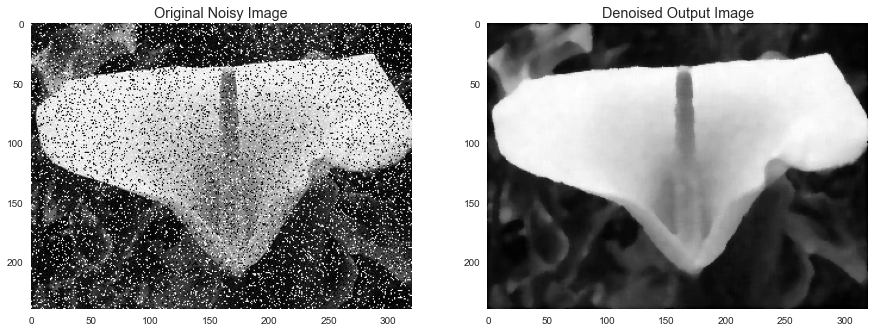

In [19]:
fig = plt.figure(figsize=(15,15))
ax1 = plt.subplot(121)
ax2 = plt.subplot(122)

ax1.set_title("Original Noisy Image")
ax2.set_title("Denoised Output Image")

imshow(noisy, ax=ax1)
imshow(res_noisy_median, ax=ax2)

<hr>

# Q2)

## 2.1: Applying Canny to `bell.jpg`

In [20]:
bell = cv.imread(IMG_SRC+"bell.jpg", 0)
res_bell_canny = cv.Canny(bell, 40, 170)

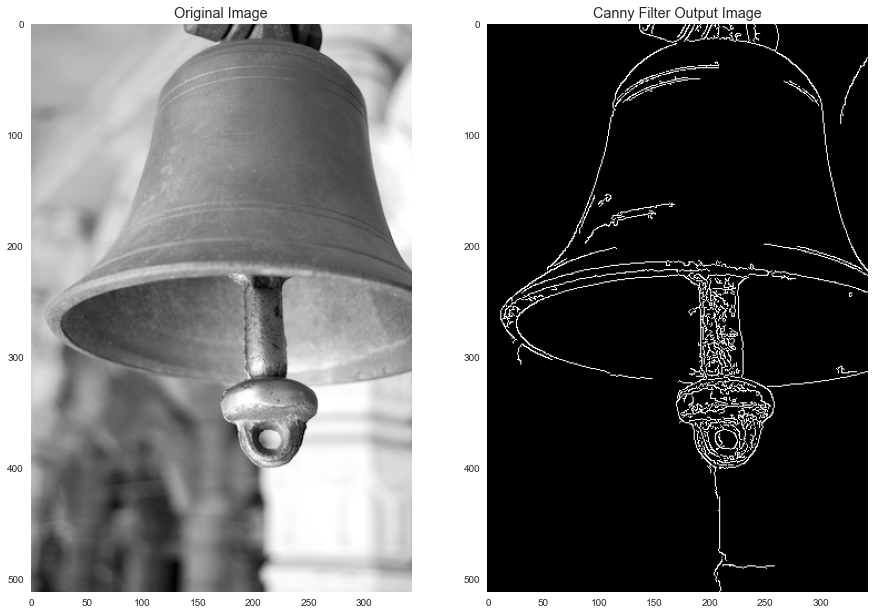

In [21]:
fig = plt.figure(figsize=(15,15))
ax1 = plt.subplot(121)
ax2 = plt.subplot(122)

ax1.set_title("Original Image")
ax2.set_title("Canny Filter Output Image")

imshow(bell, ax=ax1)
imshow(res_bell_canny, ax=ax2)

<hr>

## 2.2: Tweaking the Parameters of Canny Filter
* The parameters **minVal** and **maxVal** of the Canny filter are tweaked to give the best results for edge detection on `bell.jpg`

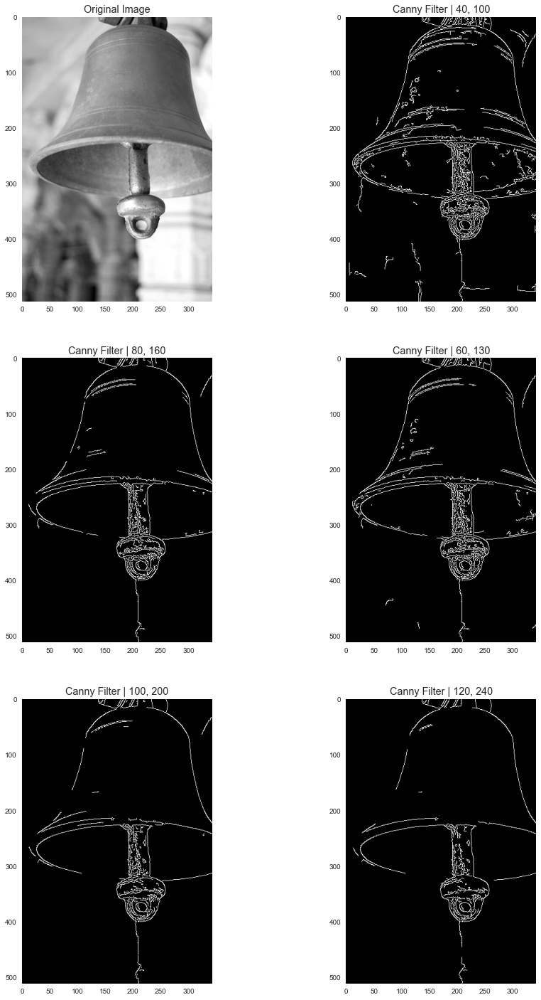

In [22]:
bell = cv.imread(IMG_SRC+"bell.jpg", 0)
canny_bell1 = cv.Canny(bell, 40, 100)
canny_bell2 = cv.Canny(bell, 80, 160)
canny_bell3 = cv.Canny(bell, 60, 130)
canny_bell4 = cv.Canny(bell, 100, 200)
canny_bell5 = cv.Canny(bell, 120, 240)

fig = plt.figure(figsize=(15,25))
ax1 = plt.subplot(321)
ax2 = plt.subplot(322)
ax3 = plt.subplot(323)
ax4 = plt.subplot(324)
ax5 = plt.subplot(325)
ax6 = plt.subplot(326)

ax1.set_title("Original Image")
ax2.set_title("Canny Filter | 40, 100")
ax3.set_title("Canny Filter | 80, 160")
ax4.set_title("Canny Filter | 60, 130")
ax5.set_title("Canny Filter | 100, 200")
ax6.set_title("Canny Filter | 120, 240")

imshow(bell, ax=ax1)
imshow(canny_bell1, ax=ax2)
imshow(canny_bell2, ax=ax3)
imshow(canny_bell3, ax=ax4)
imshow(canny_bell4, ax=ax5)
imshow(canny_bell5, ax=ax6)

### Optimum Value of *minVal* and *maxVal*

* From the plots above, we can see that the best result is obtained on setting:
    * **minVal = 100**
    * **maxVal = 200**

<hr>

## 2.3: Various Filters

* Various filters are applied to `kobe.png` and compared with the output of the Canny filter

In [29]:
kobe = cv.imread(IMG_SRC+"kobe.png",0)

Text(0.5, 1.0, 'Canny Filter on Kobe')

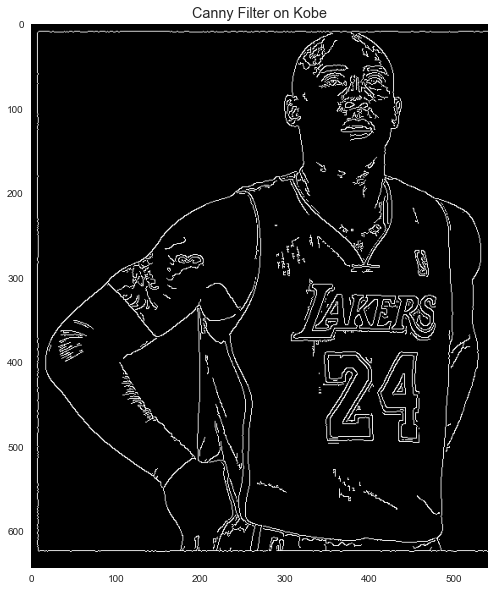

In [30]:
canny_kobe = cv.Canny(kobe,80,160)
imshow(canny_kobe)
plt.title("Canny Filter on Kobe")

### 1. Prewitt Filter

In [31]:
prewitt_3x = np.array([
    [-1,0,1],
    [-1,0,1],
    [-1,0,1]
])
prewitt_3y = np.array([
    [1,1,1],
    [0,0,0],
    [-1,-1,-1]
])

In [32]:
res_prewitt3x = conv(kobe, prewitt_3x)
res_prewitt3y = conv(kobe, prewitt_3y)

res_prewitt3x_v2 = conv(kobe, prewitt_3x, True)
res_prewitt3y_v2 = conv(kobe, prewitt_3y, True)

res_prewitt1 = combine([res_prewitt3x, res_prewitt3y], 0)
res_prewitt2 = combine([res_prewitt3x_v2, res_prewitt3y_v2], 0)
res_prewitt3 = combine([res_prewitt3x, res_prewitt3y], 1)
res_prewitt4 = combine([res_prewitt3x_v2, res_prewitt3y_v2], 1)

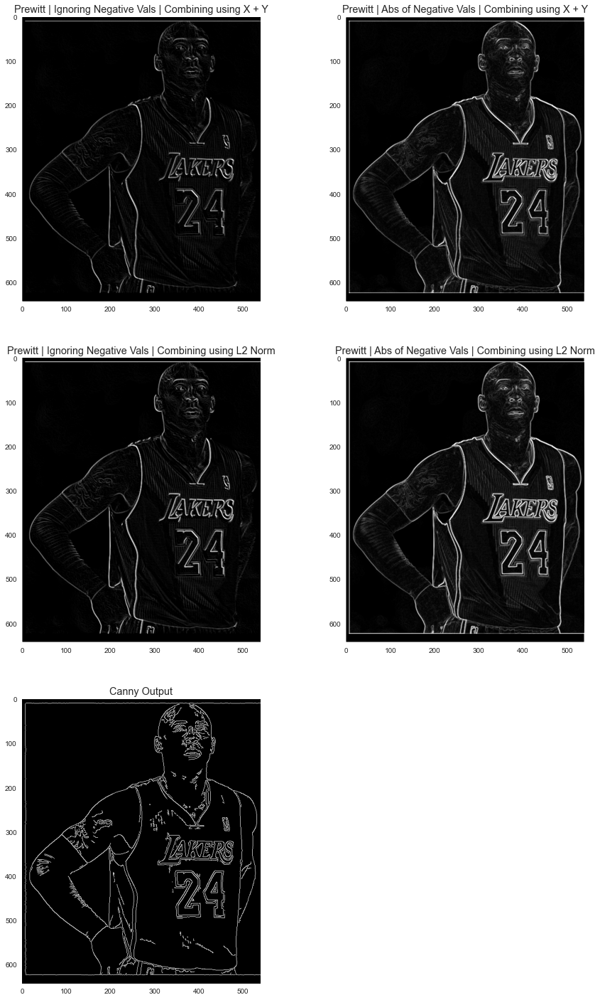

In [33]:
fig = plt.figure(figsize=(15,25))

ax1 = plt.subplot(321)
ax2 = plt.subplot(322)
ax3 = plt.subplot(323)
ax4 = plt.subplot(324)
ax5 = plt.subplot(325)

ax1.set_title("Prewitt | Ignoring Negative Vals | Combining using X + Y")
ax2.set_title("Prewitt | Abs of Negative Vals | Combining using X + Y")
ax3.set_title("Prewitt | Ignoring Negative Vals | Combining using L2 Norm")
ax4.set_title("Prewitt | Abs of Negative Vals | Combining using L2 Norm")
ax5.set_title("Canny Output")

imshow(res_prewitt1, ax=ax1)
imshow(res_prewitt2, ax=ax2)
imshow(res_prewitt3, ax=ax3)
imshow(res_prewitt4, ax=ax4)
imshow(canny_kobe, ax=ax5)

* From the above plots we can see that the **Prewitt filter** gives smoother edge detection than the **Canny filter**

### 2. Sobel Filter

In [34]:
sobel_3x = np.array([
    [-1,0,1],
    [-2,0,2],
    [-1,0,1]
])
sobel_3y = np.array([
    [1,2,1],
    [0,0,0],
    [-1,-2,-1]
])

In [35]:
res_sobel3x = conv(kobe, sobel_3x)
res_sobel3y = conv(kobe, sobel_3y)

res_sobel3x_v2 = conv(kobe, sobel_3x, True)
res_sobel3y_v2 = conv(kobe, sobel_3y, True)

res_sobel1 = combine([res_sobel3x, res_sobel3y], 0)
res_sobel2 = combine([res_sobel3x_v2, res_sobel3y_v2], 0)
res_sobel3 = combine([res_sobel3x, res_sobel3y], 1)
res_sobel4 = combine([res_sobel3x_v2, res_sobel3y_v2], 1)

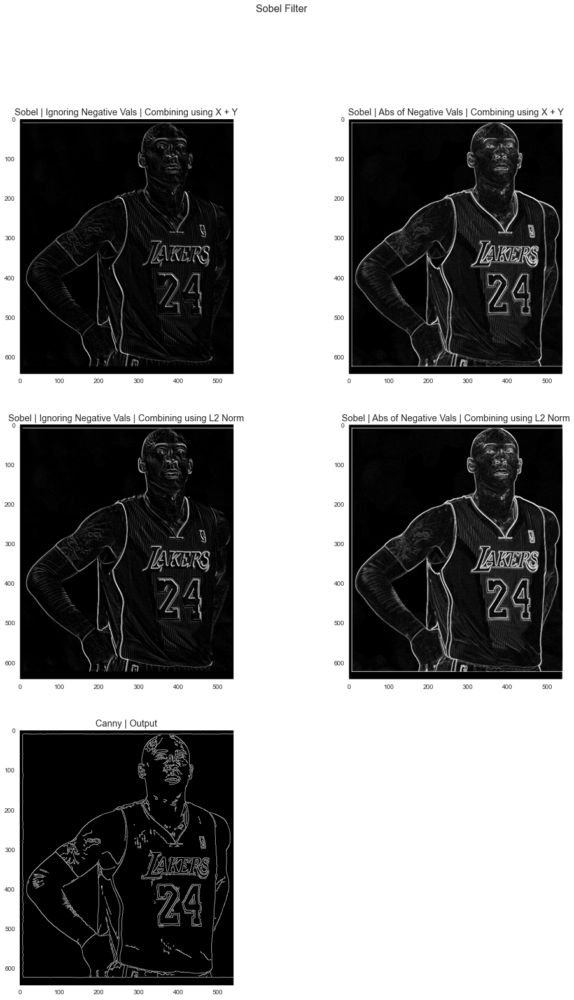

In [36]:
fig = plt.figure(figsize=(17,25))
fig.suptitle("Sobel Filter", fontsize=16)

ax1 = plt.subplot(321)
ax2 = plt.subplot(322)
ax3 = plt.subplot(323)
ax4 = plt.subplot(324)
ax5 = plt.subplot(325)

ax1.set_title("Sobel | Ignoring Negative Vals | Combining using X + Y")
ax2.set_title("Sobel | Abs of Negative Vals | Combining using X + Y")
ax3.set_title("Sobel | Ignoring Negative Vals | Combining using L2 Norm")
ax4.set_title("Sobel | Abs of Negative Vals | Combining using L2 Norm")
ax5.set_title("Canny | Output")

imshow(res_sobel1, ax=ax1)
imshow(res_sobel2, ax=ax2)
imshow(res_sobel3, ax=ax3)
imshow(res_sobel4, ax=ax4)
imshow(canny_kobe, ax=ax5)

* From the above plots we can see that the **Sobel filter** gives smoother edge detection than the **Canny filter**

### 3. Roberts Filter

In [37]:
roberts_3x = np.array([
    [0,1],
    [-1,0]
])
roberts_3y = np.array([
    [1,0],
    [0,-1]
])

In [38]:
res_roberts3x = conv(kobe, roberts_3x)
res_roberts3y = conv(kobe, roberts_3y)

res_roberts3x_v2 = conv(kobe, roberts_3x, True)
res_roberts3y_v2 = conv(kobe, roberts_3y, True)

res_roberts1 = combine([res_roberts3x, res_roberts3y], 0)
res_roberts2 = combine([res_roberts3x_v2, res_roberts3y_v2], 0)
res_roberts3 = combine([res_roberts3x, res_roberts3y], 1)
res_roberts4 = combine([res_roberts3x_v2, res_roberts3y_v2], 1)

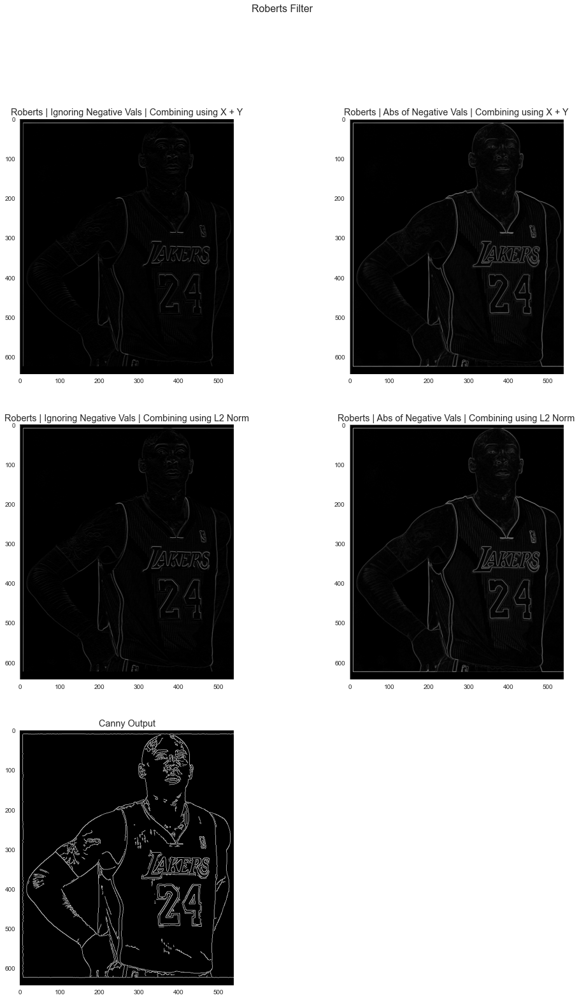

In [39]:
fig = plt.figure(figsize=(17,25))
fig.suptitle("Roberts Filter", fontsize=16)

ax1 = plt.subplot(321)
ax2 = plt.subplot(322)
ax3 = plt.subplot(323)
ax4 = plt.subplot(324)
ax5 = plt.subplot(325)

ax1.set_title("Roberts | Ignoring Negative Vals | Combining using X + Y")
ax2.set_title("Roberts | Abs of Negative Vals | Combining using X + Y")
ax3.set_title("Roberts | Ignoring Negative Vals | Combining using L2 Norm")
ax4.set_title("Roberts | Abs of Negative Vals | Combining using L2 Norm")
ax5.set_title("Canny Output")

imshow(res_roberts1, ax=ax1)
imshow(res_roberts2, ax=ax2)
imshow(res_roberts3, ax=ax3)
imshow(res_roberts4, ax=ax4)
imshow(canny_kobe, ax=ax5)

* We can see that while **Roberts filter** gives a smoother output, the **Canny filter** gives more distinct edges

### 4. Laplacian Filter 1

In [40]:
laplacian_1 = np.array([
    [0,1,0],
    [1,-4,1],
    [0,1,0]
])
laplacian_2 = np.array([
    [1,1,1],
    [1,-8,1],
    [1,1,1]
])

In [41]:
res_laplacian_1 = conv(kobe, laplacian_1)
res_laplacian_1_v2 = conv(kobe, laplacian_1, True)

res_laplacian_1_1 = combine([res_laplacian_1],0)
res_laplacian_1_2 = combine([res_laplacian_1_v2],0)
res_laplacian_1_3 = combine([res_laplacian_1],1)
res_laplacian_1_4 = combine([res_laplacian_1_v2],1)

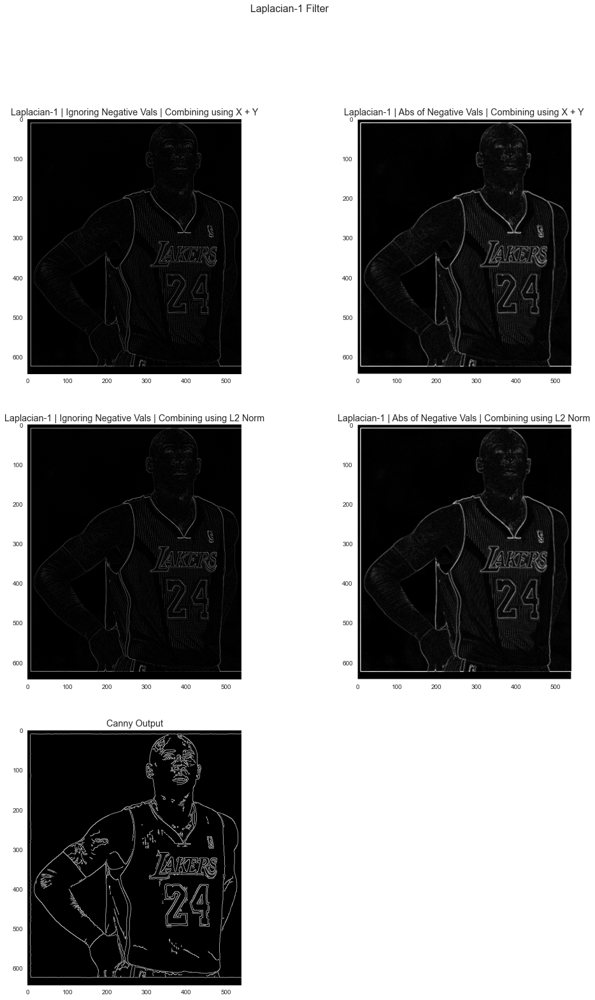

In [42]:
fig = plt.figure(figsize=(17,25))
fig.suptitle("Laplacian-1 Filter", fontsize=16)

ax1 = plt.subplot(321)
ax2 = plt.subplot(322)
ax3 = plt.subplot(323)
ax4 = plt.subplot(324)
ax5 = plt.subplot(325)

ax1.set_title("Laplacian-1 | Ignoring Negative Vals | Combining using X + Y")
ax2.set_title("Laplacian-1 | Abs of Negative Vals | Combining using X + Y")
ax3.set_title("Laplacian-1 | Ignoring Negative Vals | Combining using L2 Norm")
ax4.set_title("Laplacian-1 | Abs of Negative Vals | Combining using L2 Norm")
ax5.set_title("Canny Output")

imshow(res_laplacian_1_1, ax=ax1)
imshow(res_laplacian_1_2, ax=ax2)
imshow(res_laplacian_1_3, ax=ax3)
imshow(res_laplacian_1_4, ax=ax4)
imshow(canny_kobe, ax=ax5)

* The **Laplacian filter 1** gives smooth output which is fairly distinct as well

### 5. Laplacian Filter 2

In [43]:
res_laplacian_2 = conv(kobe, laplacian_2)
res_laplacian_2_v2 = conv(kobe, laplacian_2, True)

res_laplacian_2_1 = combine([res_laplacian_2],0)
res_laplacian_2_2 = combine([res_laplacian_2_v2],0)
res_laplacian_2_3 = combine([res_laplacian_2],1)
res_laplacian_2_4 = combine([res_laplacian_2_v2],1)

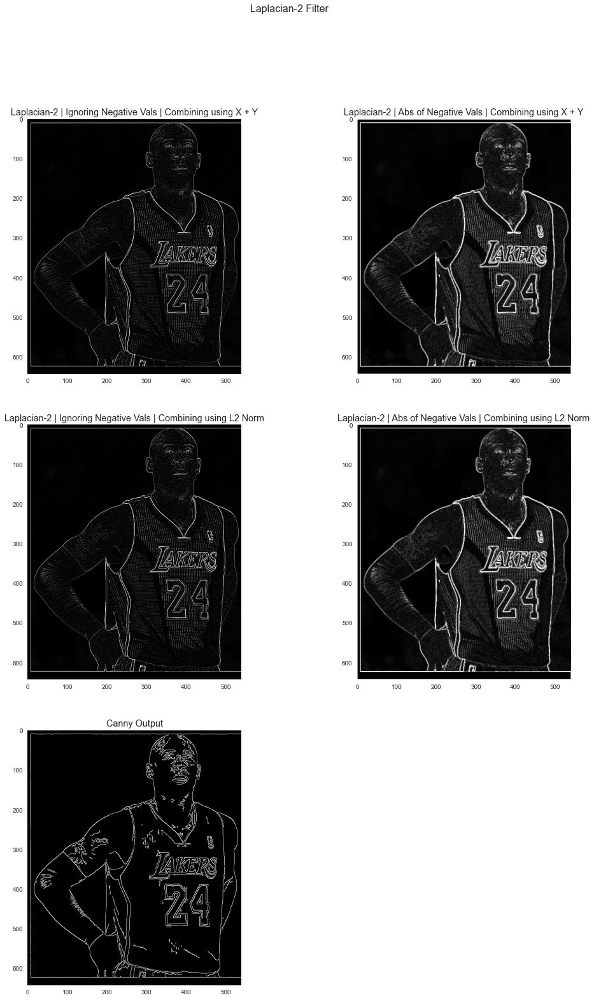

In [44]:
fig = plt.figure(figsize=(17,25))
fig.suptitle("Laplacian-2 Filter", fontsize=16)

ax1 = plt.subplot(321)
ax2 = plt.subplot(322)
ax3 = plt.subplot(323)
ax4 = plt.subplot(324)
ax5 = plt.subplot(325)

ax1.set_title("Laplacian-2 | Ignoring Negative Vals | Combining using X + Y")
ax2.set_title("Laplacian-2 | Abs of Negative Vals | Combining using X + Y")
ax3.set_title("Laplacian-2 | Ignoring Negative Vals | Combining using L2 Norm")
ax4.set_title("Laplacian-2 | Abs of Negative Vals | Combining using L2 Norm")
ax5.set_title("Canny Output")

imshow(res_laplacian_2_1, ax=ax1)
imshow(res_laplacian_2_2, ax=ax2)
imshow(res_laplacian_2_3, ax=ax3)
imshow(res_laplacian_2_4, ax=ax4)
imshow(canny_kobe, ax=ax5)

* The **Laplacian 2 filter** gives a much more distinct and smoother edge detection output compared to **Laplacian 1** and **Canny filter**

<hr>

## 2.4

### Sobel Filter 5x5

* The sobel 5x5 filter is given as follows:
$$
S_y = 
\begin{bmatrix}
1 & 4 & 6 & 4 & 1 \\
2 & 8 & 12 & 8 & 2 \\
0 & 0 & 0 & 0 & 0 \\
-2 & -8 & -12 & -8 & -2 \\
-1 & -4 & -6 & -4 & -1 \\
\end{bmatrix}
$$

$$
S_x = 
\begin{bmatrix}
-1 & -2 & 0 & 2 & 1 \\
-4 & -8 & 0 & 8 & 4 \\
-6 & -12 & 0 & 12 & 6 \\
-4 & -8 & 0 & 8 & 4 \\
-1 & -2 & 0 & 2 & 1
\end{bmatrix}
$$

* We get this due to the following reasons:
    * We know the 3x3 Sobel kernel is the outer product:
$$
\begin{bmatrix}
1 \\
2 \\
1
\end{bmatrix}
* 
\begin{bmatrix}
1 & 0 & -1
\end{bmatrix}
$$

    * On extending this using the smoothing kernel again, we get the 5x5 variant of the Sobel Kernel

In [45]:
sobel_5x = np.array([
    [1,4,6,4,1],
    [2,8,12,8,2],
    [0,0,0,0,0],
    [-2,-8,-12,-8,-2],
    [-1,-4,-6,-4,-1]
])
sobel_5y = np.array([
    [-1,-2,0,2,1],
    [-4,-8,0,8,4],
    [-6,-12,0,12,6],
    [-4,-8,0,8,4],
    [-1,-2,0,2,1]
])

In [46]:
res_sobel5x = conv(kobe, sobel_5x)
res_sobel5y = conv(kobe, sobel_5y)

res_sobel5x_v2 = conv(kobe, sobel_5x, True)
res_sobel5y_v2 = conv(kobe, sobel_5y, True)

res_sobel5_1 = combine([res_sobel5x, res_sobel5y],0)
res_sobel5_2 = combine([res_sobel5x_v2, res_sobel5y_v2],0)
res_sobel5_3 = combine([res_sobel5x, res_sobel5y],1)
res_sobel5_4 = combine([res_sobel5x_v2, res_sobel5y_v2],1)

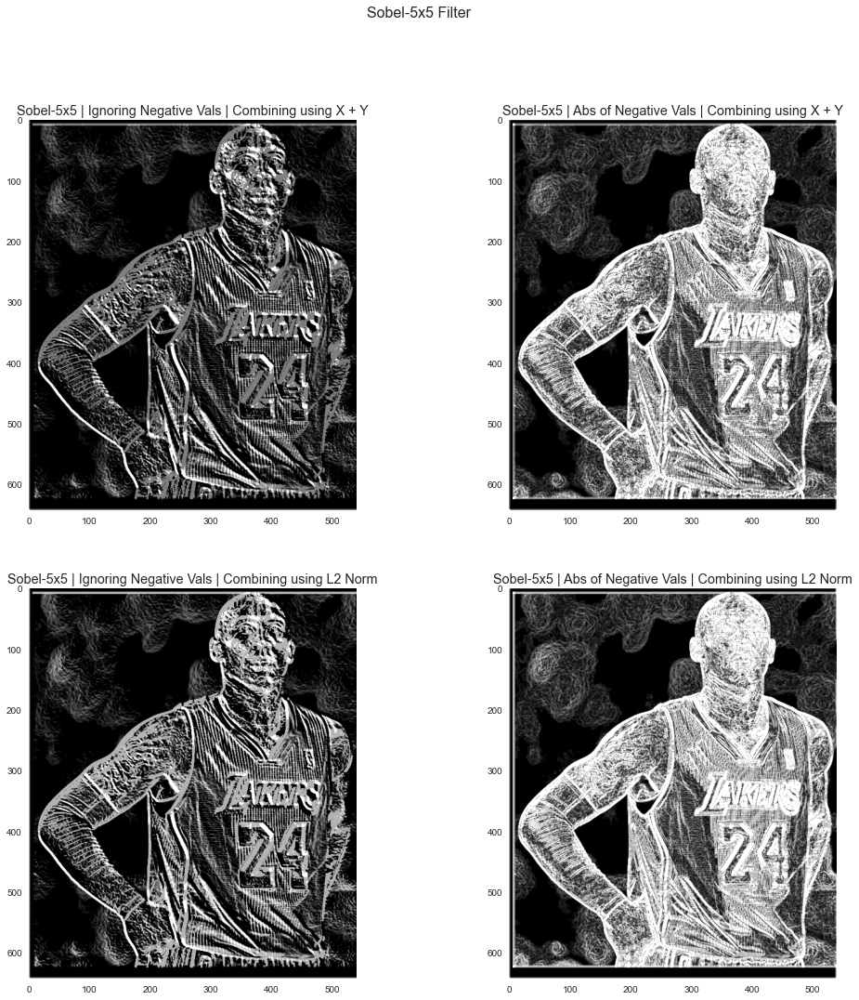

In [47]:
fig = plt.figure(figsize=(17,17))
fig.suptitle("Sobel-5x5 Filter", fontsize=16)

ax1 = plt.subplot(221)
ax2 = plt.subplot(222)
ax3 = plt.subplot(223)
ax4 = plt.subplot(224)

ax1.set_title("Sobel-5x5 | Ignoring Negative Vals | Combining using X + Y")
ax2.set_title("Sobel-5x5 | Abs of Negative Vals | Combining using X + Y")
ax3.set_title("Sobel-5x5 | Ignoring Negative Vals | Combining using L2 Norm")
ax4.set_title("Sobel-5x5 | Abs of Negative Vals | Combining using L2 Norm")

imshow(res_sobel5_1, ax=ax1)
imshow(res_sobel5_2, ax=ax2)
imshow(res_sobel5_3, ax=ax3)
imshow(res_sobel5_4, ax=ax4)

* We can see that compared to the $3x3$ variant, the $5x5$ kernel detects more edges and are very prominently detected

### Prewitt Filter 5x5

* The Prewitt 5x5 filter is given as follows:
$$
P_y = 
\begin{bmatrix}
2 & 2 & 2 & 2 & 2 \\
1 & 1 & 1 & 1 & 1 \\
0 & 0 & 0 & 0 & 0 \\
-1 & -1 & -1 & -1 & -1 \\
-2 & -2 & -2 & -2 & -2 \\
\end{bmatrix}
$$

$$
P_x = 
\begin{bmatrix}
-2 & -1 & 0 & 1 & 2 \\
-2 & -1 & 0 & 1 & 2 \\
-2 & -1 & 0 & 1 & 2 \\
-2 & -1 & 0 & 1 & 2 \\
-2 & -1 & 0 & 1 & 2
\end{bmatrix}
$$

* We get this as from the $3x3$ variant, we can deduce that the Prewitt filter performs smoothening as it calculates the gradient, and hence we extend this idea to the $5x5$ variant

In [48]:
prewitt_5x = np.array([
    [-2,-1,0,1,2],
    [-2,-1,0,1,2],
    [-2,-1,0,1,2],
    [-2,-1,0,1,2],
    [-2,-1,0,1,2]
])
prewitt_5y = np.array([
    [2,2,2,2,2],
    [1,1,1,1,1],
    [0,0,0,0,0],
    [-1,-1,-1,-1,-1],
    [-2,-2,-2,-2,-2]
])

In [49]:
res_prewitt5x = conv(kobe, prewitt_5x)
res_prewitt5y = conv(kobe, prewitt_5y)

res_prewitt5x_v2 = conv(kobe, prewitt_5x, True)
res_prewitt5y_v2 = conv(kobe, prewitt_5y, True)

res_prewitt5_1 = combine([res_prewitt5x, res_prewitt5y],0)
res_prewitt5_2 = combine([res_prewitt5x_v2, res_prewitt5y_v2],0)
res_prewitt5_3 = combine([res_prewitt5x, res_prewitt5y],1)
res_prewitt5_4 = combine([res_prewitt5x_v2, res_prewitt5y_v2],1)

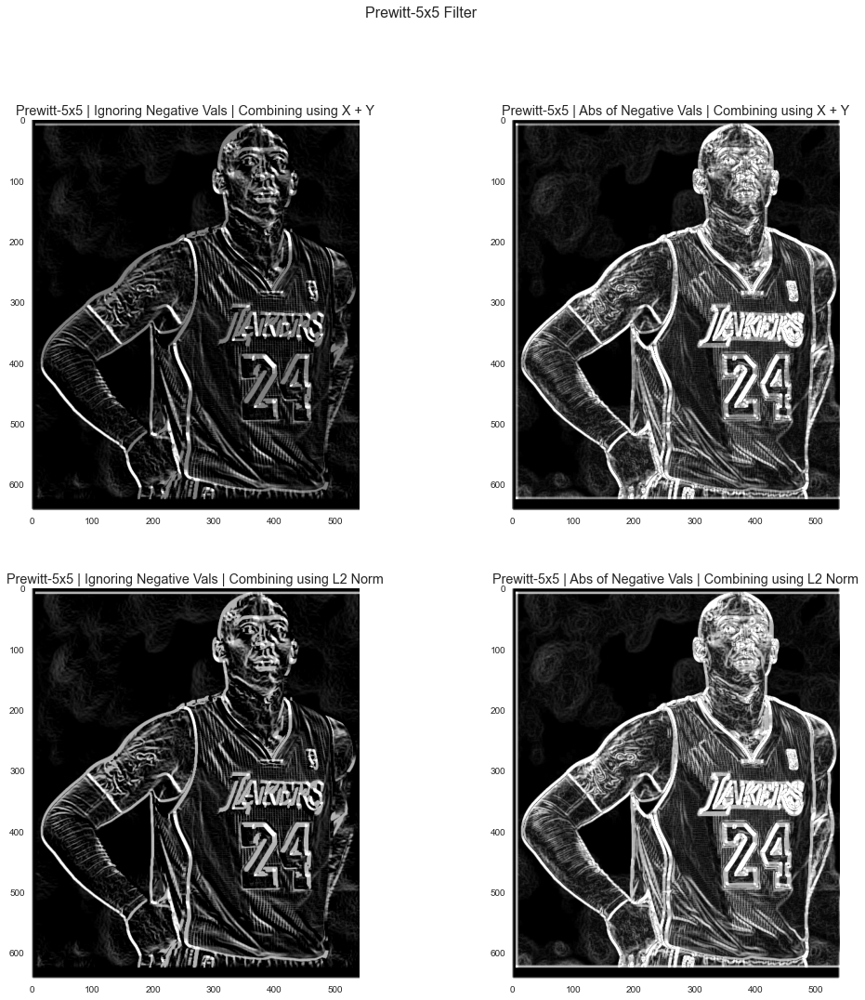

In [50]:
fig = plt.figure(figsize=(17,17))
fig.suptitle("Prewitt-5x5 Filter", fontsize=16)

ax1 = plt.subplot(221)
ax2 = plt.subplot(222)
ax3 = plt.subplot(223)
ax4 = plt.subplot(224)

ax1.set_title("Prewitt-5x5 | Ignoring Negative Vals | Combining using X + Y")
ax2.set_title("Prewitt-5x5 | Abs of Negative Vals | Combining using X + Y")
ax3.set_title("Prewitt-5x5 | Ignoring Negative Vals | Combining using L2 Norm")
ax4.set_title("Prewitt-5x5 | Abs of Negative Vals | Combining using L2 Norm")

imshow(res_prewitt5_1, ax=ax1)
imshow(res_prewitt5_2, ax=ax2)
imshow(res_prewitt5_3, ax=ax3)
imshow(res_prewitt5_4, ax=ax4)

* We see that the filter detects more edges more prominently compared to the $3x3$ variant

<hr>

## 2.5: Effect of Noise on the Filters

In [51]:
def all_filters(img):
    
    canny_img_noisy = cv.Canny(img, 80, 160)
    
    res_prewitt5x = conv(img, prewitt_5x, True)
    res_prewitt5y = conv(img, prewitt_5y, True)
    res_prewitt5 = combine([res_prewitt5x, res_prewitt5y],1)
    
    res_sobel5x = conv(img, sobel_5x, True)
    res_sobel5y = conv(img, sobel_5y, True)
    res_sobel5 = combine([res_sobel5x, res_sobel5y],1)
    
    res_laplacian_1 = conv(img, laplacian_1, True)
    res_laplacian_1 = combine([res_laplacian_1],1)
    
    res_laplacian_2 = conv(img, laplacian_2, True)
    res_laplacian_2 = combine([res_laplacian_2],1)
    
    res_roberts3x = conv(img, roberts_3x, True)
    res_roberts3y = conv(img, roberts_3y, True)
    res_roberts = combine([res_roberts3x, res_roberts3y], 1)
    
    res_sobel3x = conv(img, sobel_3x, True)
    res_sobel3y = conv(img, sobel_3y, True)
    res_sobel3 = combine([res_sobel3x, res_sobel3y], 1)
    
    res_prewitt3x = conv(img, prewitt_3x, True)
    res_prewitt3y = conv(img, prewitt_3y, True)
    res_prewitt3 = combine([res_prewitt3x, res_prewitt3y], 1)
    
    fig = plt.figure(figsize=(18,25))
    ax1 = plt.subplot(331)
    ax2 = plt.subplot(332)
    ax3 = plt.subplot(333)
    ax4 = plt.subplot(334)
    ax5 = plt.subplot(335)
    ax6 = plt.subplot(336)
    ax7 = plt.subplot(337)
    ax8 = plt.subplot(338)
    ax9 = plt.subplot(339)
    
    ax1.set_title("Noisy Original")
    ax2.set_title("Canny")
    ax3.set_title("Prewitt 3x3")
    ax4.set_title("Sobel 3x3")
    ax5.set_title("Roberts")
    ax6.set_title("Laplacian-1")
    ax7.set_title("Laplacian-2")
    ax8.set_title("Prewitt 5x5")
    ax9.set_title("Sobel 5x5")
    
    imshow(img, ax=ax1)
    imshow(canny_img_noisy, ax=ax2)
    imshow(res_prewitt3, ax=ax3)
    imshow(res_sobel3, ax=ax4)
    imshow(res_roberts, ax=ax5)
    imshow(res_laplacian_1, ax=ax6)
    imshow(res_laplacian_2, ax=ax7)
    imshow(res_prewitt5, ax=ax8)
    imshow(res_sobel5, ax=ax9)

### Low Noise

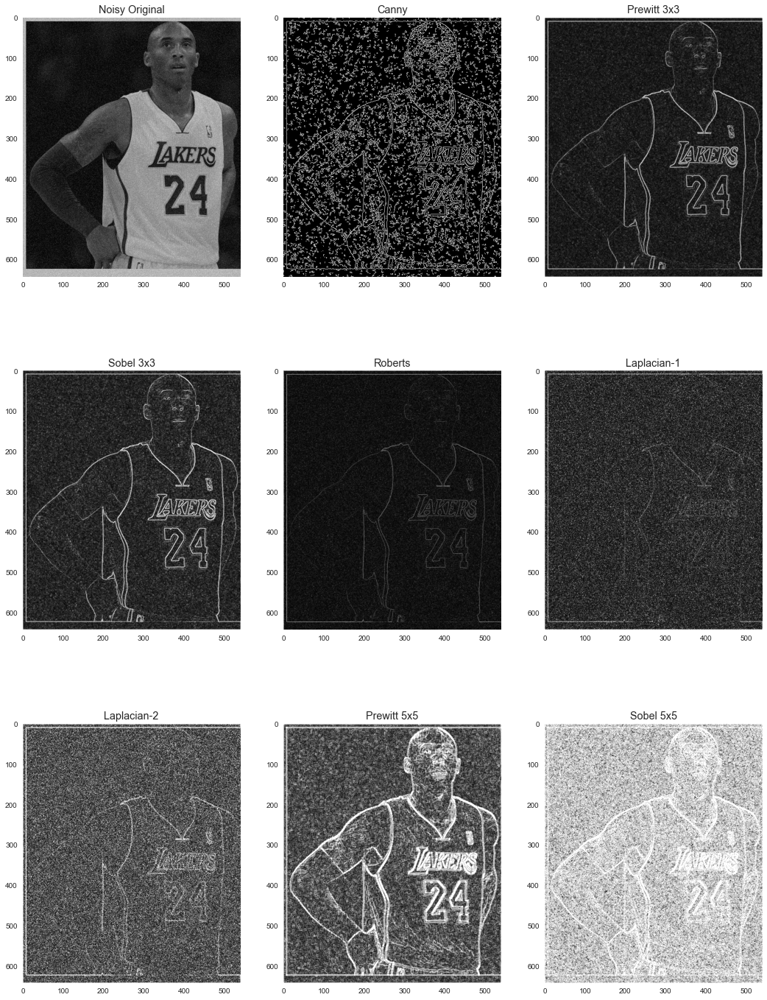

In [52]:
kobe_noisy = kobe.astype('float32') + np.abs(32*np.random.normal(0,1, kobe.shape)).astype('float32')
kobe_noisy = (kobe_noisy*255/kobe_noisy.max()).astype('uint8')
all_filters(kobe_noisy)

#### Effect on Variants of Canny

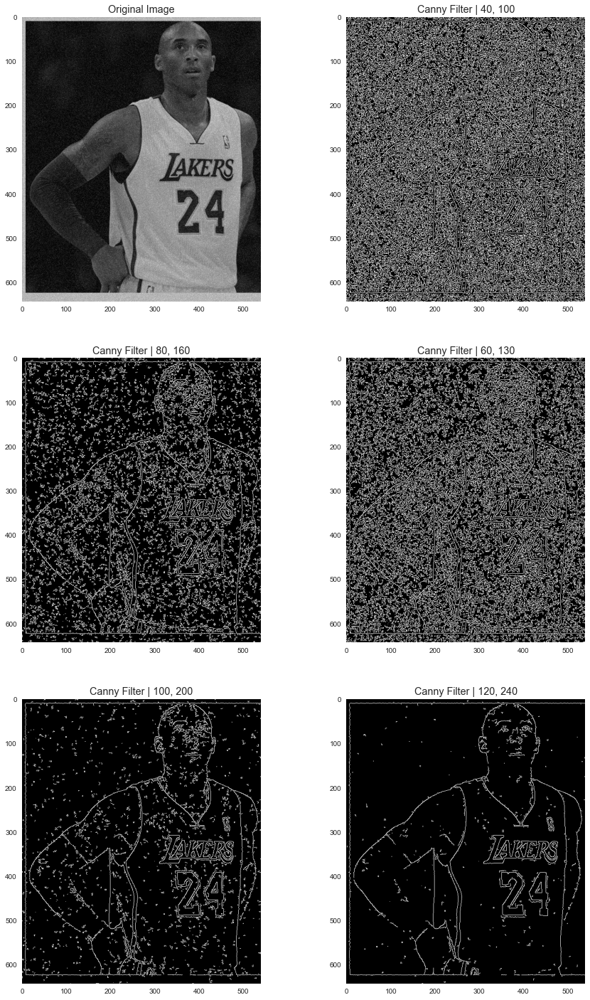

In [53]:
kobe_noisy1 = cv.Canny(kobe_noisy, 40, 100)
kobe_noisy2 = cv.Canny(kobe_noisy, 80, 160)
kobe_noisy3 = cv.Canny(kobe_noisy, 60, 130)
kobe_noisy4 = cv.Canny(kobe_noisy, 100, 200)
kobe_noisy5 = cv.Canny(kobe_noisy, 120, 240)

fig = plt.figure(figsize=(15,25))
ax1 = plt.subplot(321)
ax2 = plt.subplot(322)
ax3 = plt.subplot(323)
ax4 = plt.subplot(324)
ax5 = plt.subplot(325)
ax6 = plt.subplot(326)

ax1.set_title("Original Image")
ax2.set_title("Canny Filter | 40, 100")
ax3.set_title("Canny Filter | 80, 160")
ax4.set_title("Canny Filter | 60, 130")
ax5.set_title("Canny Filter | 100, 200")
ax6.set_title("Canny Filter | 120, 240")

imshow(kobe_noisy, ax=ax1)
imshow(kobe_noisy1, ax=ax2)
imshow(kobe_noisy2, ax=ax3)
imshow(kobe_noisy3, ax=ax4)
imshow(kobe_noisy4, ax=ax5)
imshow(kobe_noisy5, ax=ax6)

* We see that the last 2 plots give a more or less accurate representation of the edges, albeit a bit noisy

### Medium Noise

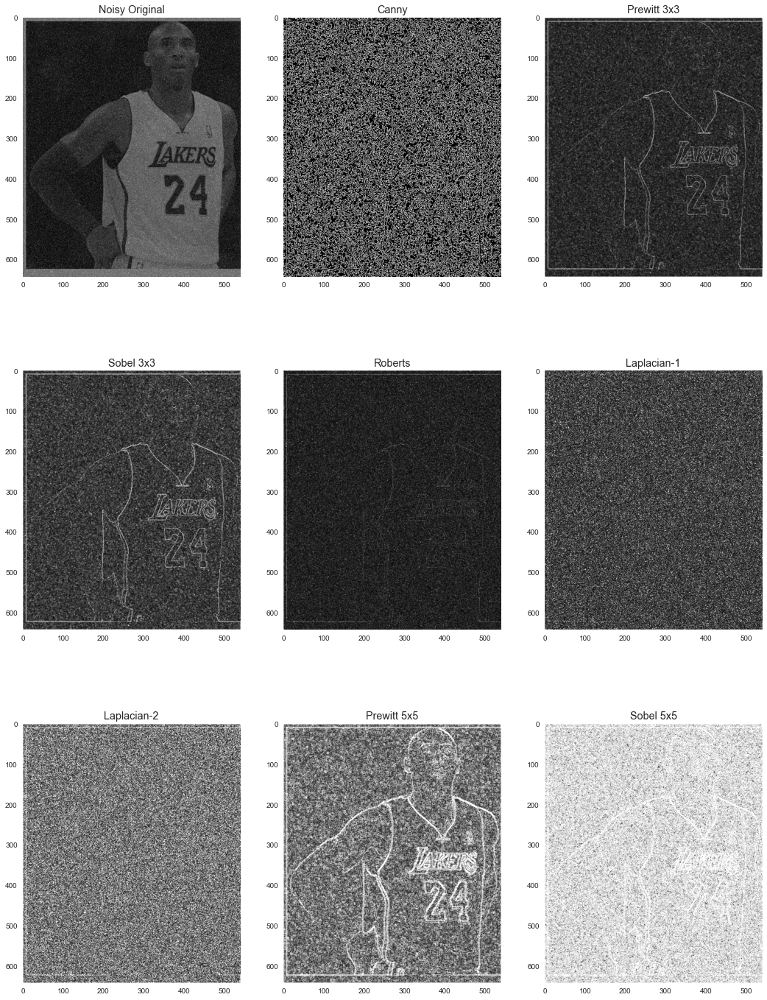

In [54]:
kobe_noisy_med = kobe.astype('float32') + np.abs(90*np.random.normal(0,1, kobe.shape)).astype('float32')
kobe_noisy_med = (kobe_noisy_med*255/kobe_noisy_med.max()).astype('uint8')
all_filters(kobe_noisy_med)
# imshow(kobe_noisy)

#### Effect on Canny

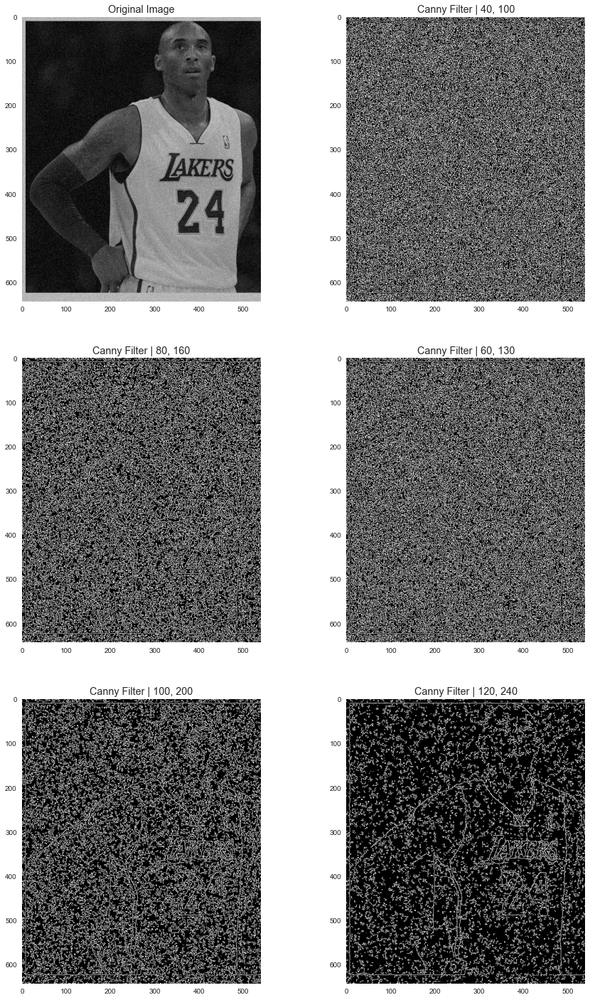

In [55]:
kobe_noisy1 = cv.Canny(kobe_noisy_med, 40, 100)
kobe_noisy2 = cv.Canny(kobe_noisy_med, 80, 160)
kobe_noisy3 = cv.Canny(kobe_noisy_med, 60, 130)
kobe_noisy4 = cv.Canny(kobe_noisy_med, 100, 200)
kobe_noisy5 = cv.Canny(kobe_noisy_med, 120, 240)

fig = plt.figure(figsize=(15,25))
ax1 = plt.subplot(321)
ax2 = plt.subplot(322)
ax3 = plt.subplot(323)
ax4 = plt.subplot(324)
ax5 = plt.subplot(325)
ax6 = plt.subplot(326)

ax1.set_title("Original Image")
ax2.set_title("Canny Filter | 40, 100")
ax3.set_title("Canny Filter | 80, 160")
ax4.set_title("Canny Filter | 60, 130")
ax5.set_title("Canny Filter | 100, 200")
ax6.set_title("Canny Filter | 120, 240")

imshow(kobe_noisy, ax=ax1)
imshow(kobe_noisy1, ax=ax2)
imshow(kobe_noisy2, ax=ax3)
imshow(kobe_noisy3, ax=ax4)
imshow(kobe_noisy4, ax=ax5)
imshow(kobe_noisy5, ax=ax6)

* We can see that it's extremely hard for the Canny filter to detect the edges accurately

<hr>

# Q3)

## 3.1: Implementing the Bilateral Filter

* The bilateral filter is implemented using the formulas given in the link attached in the assignment PDF
* The formula in the PDF is given as:
$$
BF[I]_p = \frac{1}{W_p}*\sum_{q\in S}G_{\sigma_s}(||p-q||)*G_{\sigma_r}(I_p - I_q)*I_q
$$
where $G_{\sigma}(x)$ represents the gaussian function

In [56]:
def G(x, sigma):
        return (1/(2*np.pi*(sigma**2))) * np.exp(-(x**2)/(2*(sigma**2)))

In [57]:
def bilateral_filter(img, sigma_s, sigma_r, k):
    
    h,w = img.shape
    
    img = img.astype('float32')
    img_padded, h_new, w_new = pad_image(img, k)
    img_padded = img_padded.astype('float32')
    
    res = np.zeros((h,w)).astype('float32')
    
    g1 = np.array([[(i)**2 + (j)**2 for j in range(-k//2+1, k//2+1)] for i in range(-k//2+1, k//2+1)])
    g1 = (1/(2*np.pi*(sigma_r**2)))*np.exp(-g1/(2*(sigma_r**2)))
    
    md = k//2
    for i in range(h):
        for j in range(w):
            
            cval = img_padded[i+md, j+md]
            
            g2 = (img_padded[i:i+k, j:j+k] - cval)**2
            g2 = (1/(2*np.pi*(sigma_s**2)))*np.exp(-g2/(2*(sigma_s**2)))
          
            res[i,j] = np.sum(img_padded[i:i+k, j:j+k]*g2*g1)
            
            if np.sum(g2*g1):
                res[i,j]/=np.sum(g2*g1)
            
    return res

### Bilateral Filter for Colored Images

In [58]:
def bilateral_filter_rgb(img, sigma_s, sigma_r, k):
    
    print("Applying to R channel..")
    filtered_r = bilateral_filter(img[:,:,0], sigma_s, sigma_r, k)
    print("Applying to G channel..")
    filtered_g = bilateral_filter(img[:,:,1], sigma_s, sigma_r, k)
    print("Applying to B channel..")
    filtered_b = bilateral_filter(img[:,:,2], sigma_s, sigma_r, k)
    
    res = np.dstack([filtered_r, filtered_g, filtered_b])
    res = np.clip(res, 0, 255)
    res = res.astype('uint8')
    
    return res

In [59]:
mountain = cv.imread(IMG_SRC+"mountain.jpg")
mountain = cv.cvtColor(mountain, cv.COLOR_RGB2BGR)

In [60]:
mountain_bilateral_filtered = bilateral_filter_rgb(mountain, 25, 25, 9)

Applying to R channel..
Applying to G channel..
Applying to B channel..


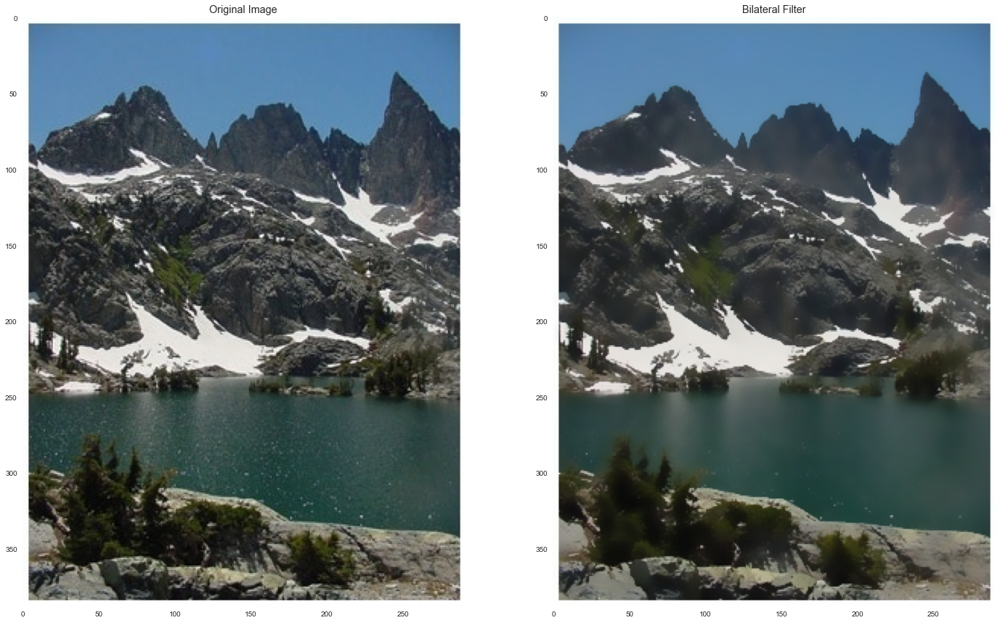

In [61]:
fig = plt.figure(figsize=(24,24))

ax1 = plt.subplot(121)
ax2 = plt.subplot(122)

ax1.set_title("Original Image")
ax2.set_title("Bilateral Filter")

imshow(mountain, col_map="", ax=ax1)
imshow(mountain_bilateral_filtered.astype('uint8'), col_map="", ax=ax2)

In [62]:
lena = cv.imread(IMG_SRC+"lena.png")
lena = cv.cvtColor(lena, cv.COLOR_RGB2BGR)
lena_bilateral_filtered = bilateral_filter_rgb(lena, 25, 25, 9)

Applying to R channel..
Applying to G channel..
Applying to B channel..


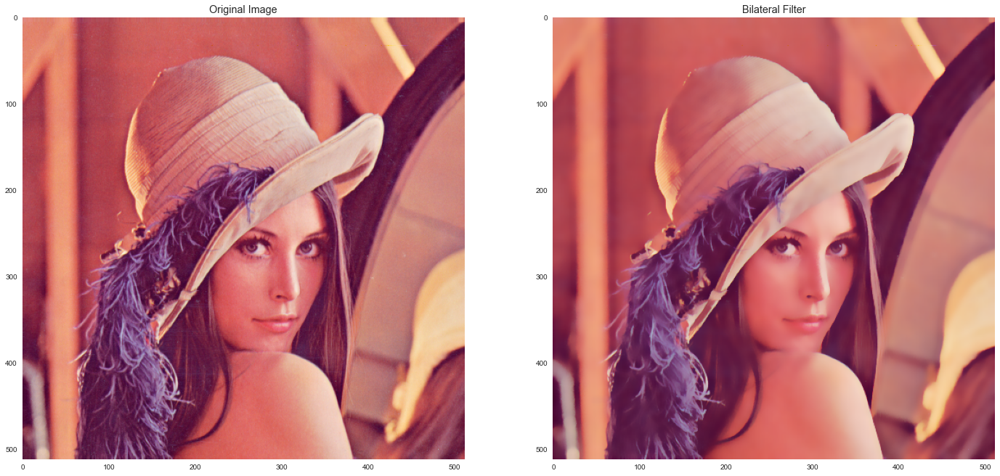

In [63]:
fig = plt.figure(figsize=(24,24))

ax1 = plt.subplot(121)
ax2 = plt.subplot(122)

ax1.set_title("Original Image")
ax2.set_title("Bilateral Filter")

imshow(lena, ax=ax1)
imshow(lena_bilateral_filtered, ax=ax2)

## 3.2: Cross Bilateral Filter

* The cross bilateral filter is implemented using the formulas given in the link attached in the assignment PDF
* The formula in the PDF is given as:
$$
CBF[I]_p = \frac{1}{W_p}*\sum_{q\in S}G_{\sigma_s}(||p-q||)*G_{\sigma_r}(E_p - E_q)*I_q
$$
where 
    * $G_{\sigma}(x)$ represents the gaussian function,
    * $E_i$ is the pixel intensity of the $i^{th}$ pixel in image $E$
    * $I_i$ is the pixel intensity of the $i^{th}$ pixel in image $I$


In [64]:
def norm(a, b):
    
    ans = 0
    for i in range(len(a)):
        ans += (a[i] - b[i])**2
    return ans**(0.5)

def cross_bilateral_filter(I, E, sigma_s, sigma_r, k):
    
    h,w = I.shape
    
    I = I.astype('float32')
    I_padded, h_new, w_new = pad_image(I, k)
    I_padded = I_padded.astype('float32')
    
    E = E.astype('float32')
    E_padded, h_new, w_new = pad_image(E, k)
    E_padded = E_padded.astype('float32')
    
    res = np.zeros((h,w)).astype('float32')
    
    g1 = np.array([[(i)**2 + (j)**2 for j in range(-k//2+1, k//2+1)] for i in range(-k//2+1, k//2+1)])
    g1 = (1/(2*np.pi*(sigma_r**2)))*np.exp(-g1/(2*(sigma_r**2)))
    
    md = k//2
    for i in range(h):
        
        if (i % 100 == 0):
            print(i*100/h, "% done")
        for j in range(w):
            
            cval = E_padded[i+md, j+md]
            
            g2 = (E_padded[i:i+k, j:j+k] - cval)**2
            g2 = (1/(2*np.pi*(sigma_s**2)))*np.exp(-g2/(2*(sigma_s**2)))
          
            res[i,j] = np.sum(I_padded[i:i+k, j:j+k]*g2*g1)
            
            if np.sum(g2*g1):
                res[i,j]/=np.sum(g2*g1)
            
    return res


## 3.3: Combining `cake-flash.jpg` and `cake-noflash.jpg`

In [65]:
cake_flash = cv.imread(IMG_SRC+"cake_flash.jpg")
cake_noflash = cv.imread(IMG_SRC+"cake_noflash.jpg")

cake_flash = cv.cvtColor(cake_flash, cv.COLOR_RGB2BGR)
cake_noflash = cv.cvtColor(cake_noflash, cv.COLOR_RGB2BGR)

#### Setting Parameters

In [66]:
k = 7
sigma_s = 25
sigma_r = 25

#### Performing CBF on `cake-noflash.jpg` using edge data from `cake-flash.jpg`

In [67]:
op_r = cross_bilateral_filter(cake_noflash[:,:,0], cake_flash[:,:,0], sigma_s, sigma_r, k)
op_g = cross_bilateral_filter(cake_noflash[:,:,1], cake_flash[:,:,1], sigma_s, sigma_r, k)
op_b = cross_bilateral_filter(cake_noflash[:,:,2], cake_flash[:,:,2], sigma_s, sigma_r, k)

0.0 % done
13.020833333333334 % done
26.041666666666668 % done
39.0625 % done
52.083333333333336 % done
65.10416666666667 % done
78.125 % done
91.14583333333333 % done
0.0 % done
13.020833333333334 % done
26.041666666666668 % done
39.0625 % done
52.083333333333336 % done
65.10416666666667 % done
78.125 % done
91.14583333333333 % done
0.0 % done
13.020833333333334 % done
26.041666666666668 % done
39.0625 % done
52.083333333333336 % done
65.10416666666667 % done
78.125 % done
91.14583333333333 % done


#### Transforming datatype of output

In [68]:
op_rc = op_r.astype('int32')
op_gc = op_g.astype('int32')
op_bc = op_b.astype('int32')

#### Combining into the RGB values

Text(0.5, 1.0, 'Output of CBF')

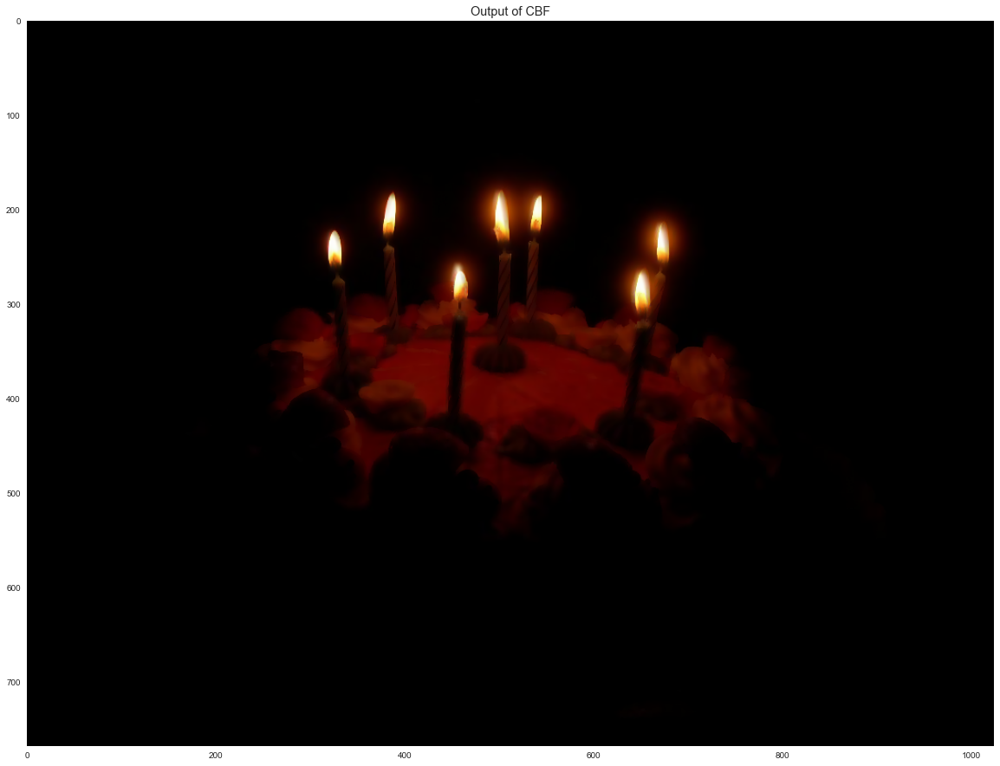

In [69]:
combined_rgb = np.dstack([op_rc, op_gc, op_bc])
combined_rgb.shape

imshow(combined_rgb, col_map="", figsize=(20,20))
plt.title("Output of CBF")

#### Combining in the log domain as mentioned in the paper

In [70]:
comb_log = 0.15*np.log(combined_rgb.astype('float32')+1)
cake_log = 0.85*np.log(cake_flash.astype('float32')+1)

final_op = np.exp(comb_log + cake_log)
final_op = np.clip(final_op, 0, 255)
final_op = final_op.astype('uint8')
np.max(final_op)

255

#### Displaying the Outputs Obtained

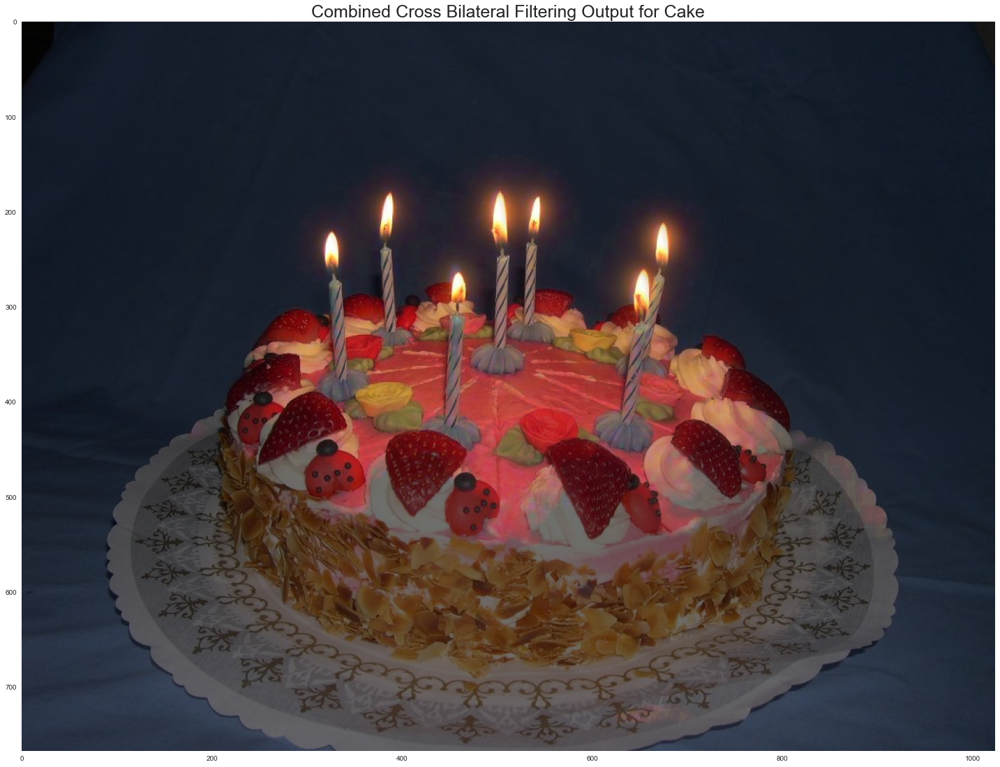

In [71]:
imshow(final_op.astype('uint8'), col_map="", figsize=(25,25))
plt.title("Combined Cross Bilateral Filtering Output for Cake", fontsize=25)
plt.imsave(IMG_SRC+"cake_cross_bilateral_output.png", final_op)

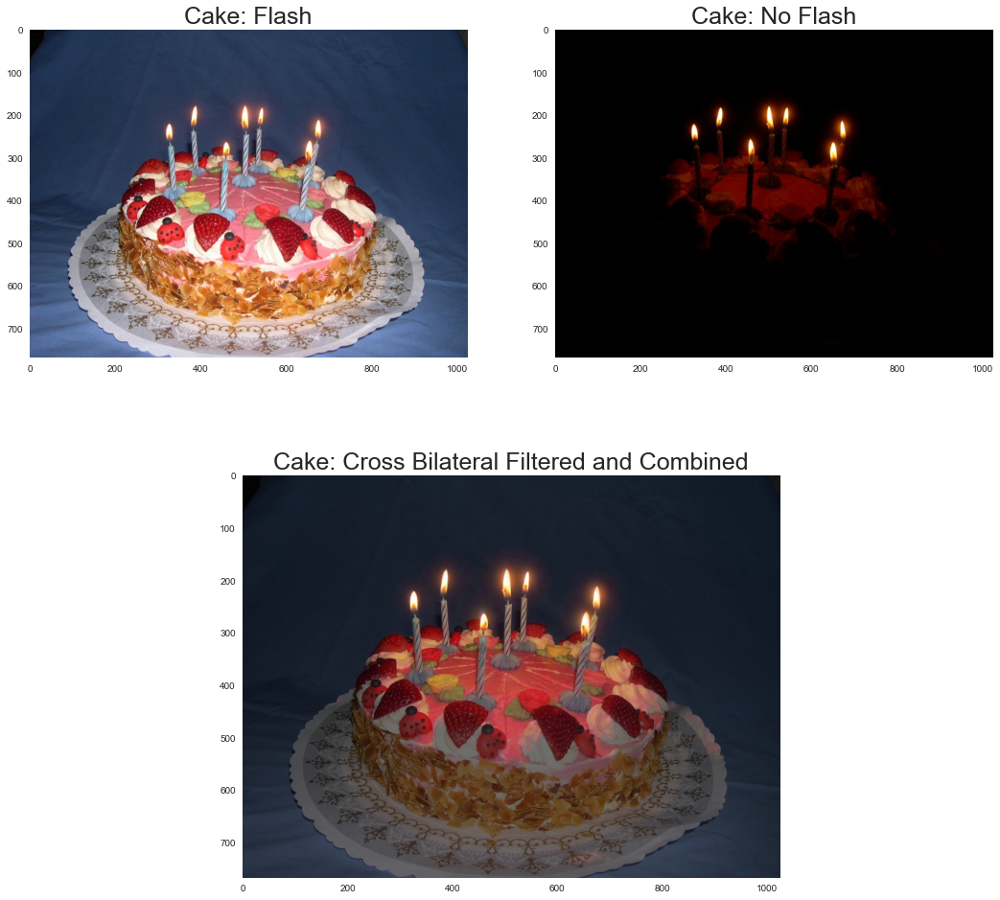

In [72]:
fig = plt.figure(figsize = (18,17))
ax1 = plt.subplot(221)
ax2 = plt.subplot(222)
ax3 = plt.subplot(212)

ax1.set_title("Cake: Flash", fontsize=25)
ax2.set_title("Cake: No Flash", fontsize=25)
ax3.set_title("Cake: Cross Bilateral Filtered and Combined", fontsize=25)

imshow(cake_flash, col_map="", ax=ax1, figsize=(20,20))
imshow(cake_noflash, col_map="", ax=ax2, figsize=(20,20))
imshow(final_op, col_map="", ax=ax3, figsize=(20,20))

<hr>

# Q4) Generating Cartoons

* The `cartoonify()` function written below converts the input into a cartoon
* It performs the following operations:
    * Applies **bilateral filtering** to a copy of the image
    * Converts another copy of the image to **grayscale**
    * Applies **blurring** on the grayscale copy to reduce noise
    * Finds the edges and **creates an edge mask** using the `adaptive_threshold()` function written below
    * **Combines** the **edge mask** and the **bilaterally filtered copy** using **bitwise AND** to produce the final image

In [73]:
def adaptive_threshold(img, k):
    
    h,w = img.shape
    img_padded, h_new, w_new = pad_image(img, k)
    img_padded = img_padded.astype('float32')
    
    res = np.zeros((h,w)).astype('float32')
    
    for i in range(h):
        for j in range(w):
            
            curr = img_padded[i:i+k, j:j+k]
            thres = np.mean(curr) - 5
            
            if img_padded[i+k//2, j+k//2] >= thres:
                res[i,j] = 255
    
    return res.astype('uint8')

def cartoonify(img, md_k=3, at_k=43, blur_k=9, sigma_s=20, sigma_r=20, k_bf=7):
    
    
    img_bf = bilateral_filter_rgb(img, sigma_s,sigma_r,k_bf)
    
    img_gray = cv.cvtColor(img, cv.COLOR_RGB2GRAY) 
    img_g_blur = mean_filter_optimized(img_gray, blur_k)
    edges = img_gray.astype('int32') - img_g_blur.astype('int32')
    
    edge_mask1 = adaptive_threshold(edges, at_k)
    edge_mask1 = median_filter_optimized(edge_mask1,md_k).astype('uint8')
    
    cartoon = np.dstack([edge_mask1]*3) & img_bf
    return cartoon

#### Generating Cartoon 1

In [74]:
img = cv.imread(IMG_SRC+"me9.jpg")
img = cv.cvtColor(img, cv.COLOR_RGB2BGR)
img = cv.resize(img, (img.shape[1]//3, img.shape[0]//3))

In [75]:
c1 = cartoonify(img, 2, 21, 15)

Applying to R channel..
Applying to G channel..
Applying to B channel..


#### Generating Cartoon 2

In [76]:
dog = cv.imread(IMG_SRC+"dog.jpg")
dog = cv.cvtColor(dog, cv.COLOR_RGB2BGR)

In [77]:
c2 = cartoonify(dog, 2, 27, 19)

Applying to R channel..
Applying to G channel..
Applying to B channel..


#### Generating Cartoon 3

In [78]:
mango_vc = cv.imread(IMG_SRC+"vc.jpeg")
mango_vc = cv.cvtColor(mango_vc, cv.COLOR_RGB2BGR)
mango_vc = cv.resize(mango_vc, (653, 900))

In [79]:
c3 = cartoonify(mango_vc, 1, 17, 23)

Applying to R channel..
Applying to G channel..
Applying to B channel..


#### Generating Cartoon 4

In [80]:
messi = cv.imread(IMG_SRC+"messi.jpg")
messi = cv.cvtColor(messi, cv.COLOR_RGB2BGR)

In [81]:
c4 = cartoonify(messi, 5, 59, 9)

Applying to R channel..
Applying to G channel..
Applying to B channel..


#### Displaying all the Cartoons

Cartoons:


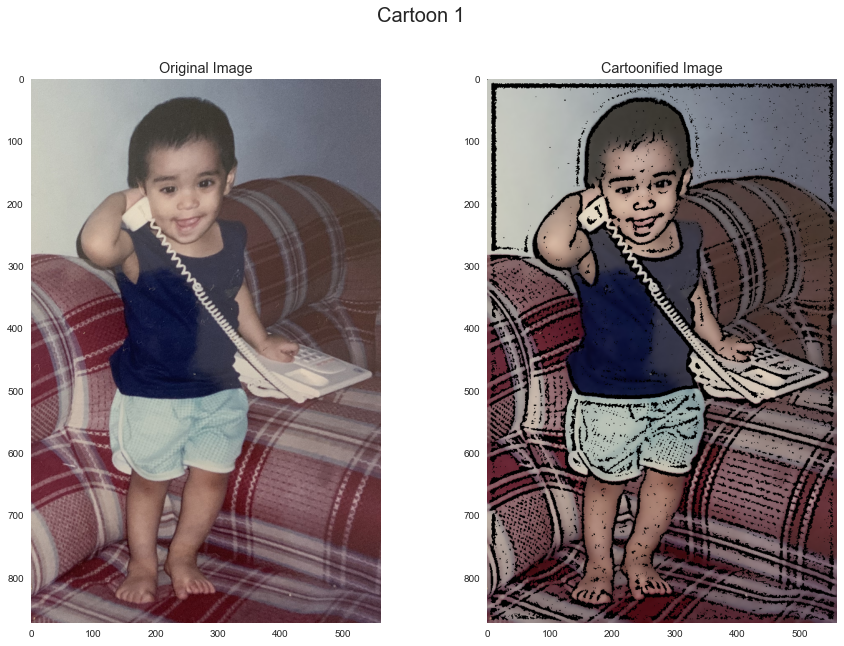

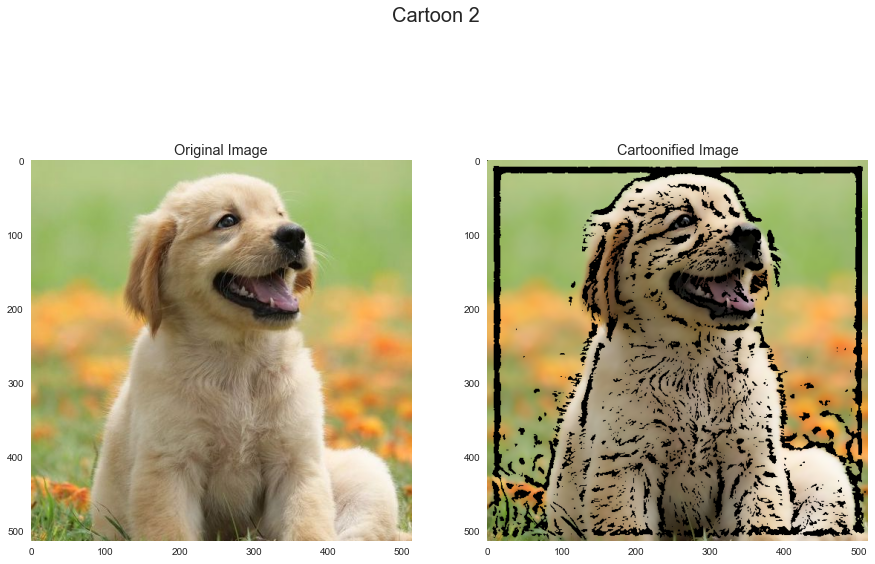

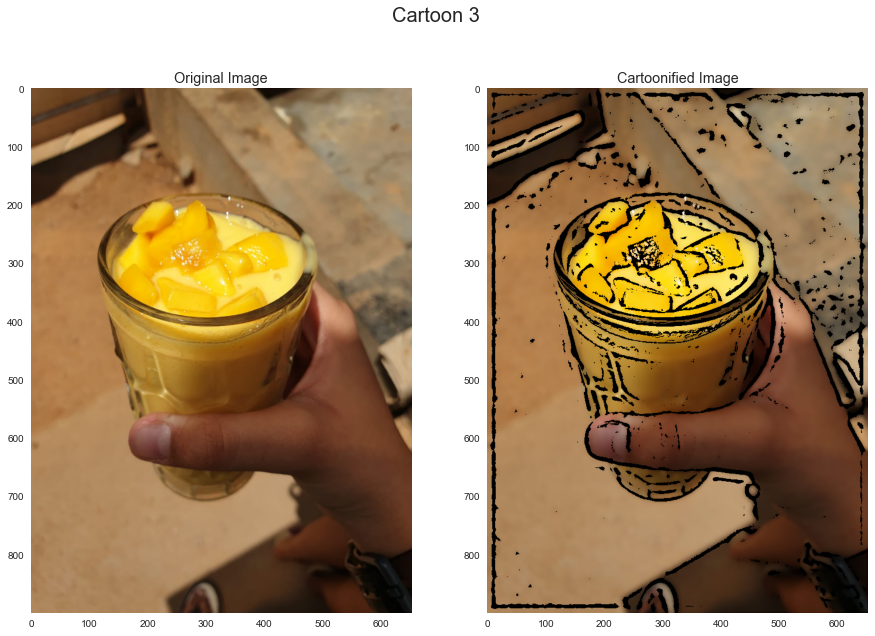

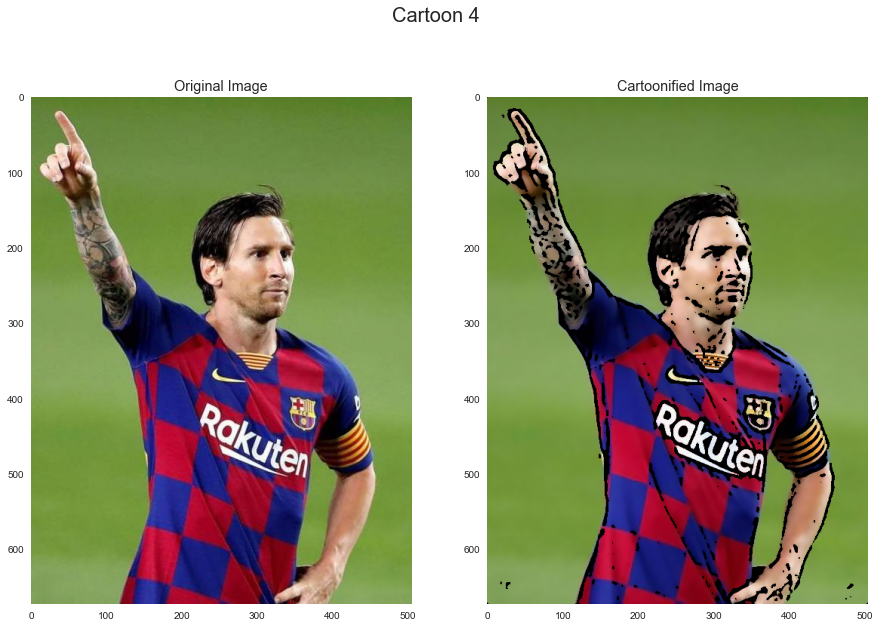

In [82]:
cartoons_orig = [img, dog, mango_vc, messi]
cartoons = [c1, c2, c3, c4]

print("Cartoons:")

for i in range(len(cartoons)):
    fig = plt.figure(figsize=(15,10))
    fig.suptitle("Cartoon "+str(i+1), fontsize=20)
    ax1 = plt.subplot(121)
    ax2 = plt.subplot(122)
    
    ax1.set_title("Original Image")
    ax2.set_title("Cartoonified Image")
    
    imshow(cartoons_orig[i], ax=ax1)
    imshow(cartoons[i], ax=ax2)
    
    plt.show()

<hr>

# Q5)

## 5.1: Implementing DFT
* Two versions of DFT are implemented below:
    * Using for loop
    * Using vectorization
* We notice that the vectorized version performs better than the non vectorized version
* The formula used is:
$$
F[x,y] = \sum_{m=0}^{M}\sum_{n=0}^{N}f[m,n]*e^{-j2\pi(\frac{x}{M}m + \frac{y}{N}n)}
$$

In [83]:
def dft_2d_loop(img):
    
    M,N = img.shape
    img = img.astype('float32')
    
    F = np.zeros((M,N), dtype=np.complex_)
    
    for a in range(M):
        for b in range(N):
            
            s = 0.0j
            for m in range(M):
                for n in range(N):
                    
                    f1 = a*m/M
                    f2 = b*n/N
            
                    s += img[m,n]*np.exp((-1j)*2*np.pi*(f1 + f2))
            
            F[a,b] = s

    return F

def dft_2d_opt(img):
    
    M,N = img.shape
    img = img.astype('float32')
    
    F = np.zeros((M,N), dtype=np.complex_)
    
    y = np.arange(M)
    x = np.arange(N)
    tbl2, tbl = np.meshgrid(x,y)
    
    tbl = np.vstack([tbl.ravel()]*M)

    tbl3 = np.reshape(np.arange(M), (M,1))
    tbl3 = np.exp((-1j)*2*(np.pi)*tbl3*tbl/M)
    tbl3 = np.hstack([tbl3]*N)
    tbl3 = tbl3.reshape(M,N,M,N)
    
    print('A')
    
    tbl2 = np.vstack([tbl2.ravel()]*N)
    
    tbl5 = np.reshape(np.arange(N), (N,1))
    tbl4 = np.exp((-1j)*2*(np.pi)*tbl2*tbl5/N).reshape(-1,M,N)
    tbl4 = np.vstack([tbl4]*M)
    tbl4 = tbl4.reshape(M,N,M,N)

    print('B')
    
    f = tbl3*tbl4   
    g = f*img
    
    print('C')
    
    h = [[np.sum(g[i][j].ravel()) for j in range(N)] for i in range(M)]
    
    return np.array(h)

## 5.2: Implementing FFT

### Implementing 1D FFT
* The 1D FFT is implemented to improve the calculation speed of the DFT by making use of the fact that many of the factors that the input is multiplied with, ie. the **twiddle factors** are repeated when the input array is divided into elements occuring in even places and odd places
* It is implemented recursively below

In [84]:
def fft_1d_helper(arr):
    
    arr = arr.astype('complex_')
    N = len(arr)

    if N == 2:
        return np.array([arr[0] + arr[1], arr[0] - arr[1]])
    else:
        arr_e = fft_1d_helper(arr[::2])
        arr_o = fft_1d_helper(arr[1::2])
        arr_n = np.arange(N)
        coeffs = np.exp((-1j)*2*np.pi*arr_n/N)
        
        return np.hstack([arr_e+ arr_o*coeffs[:N//2], arr_e+ arr_o*coeffs[N//2:]])

def fft_1d(arr):
    
    # check if it's a power of 2 or not
    N = len(arr)
    if not ((N & (N-1) == 0) and N != 0):
        req_p = 1
        while (req_p < N):
            req_p *= 2
        new_arr = np.zeros(req_p, dtype=np.complex_)
        new_arr[:N] = arr
        arr = new_arr
    
    return fft_1d_helper(arr)
    

### Implementing 2D FFT

* The 2D FFT makes use of the 1D FFT
* It is done by first calculating the 1D FFT of each of the **rows**
* Then, we perform 1D FFT on the **columns** of the matrix resulting from the above step

* We can prove this as follows:
$$
F[x,y] = \sum_{m=0}^{M-1}\sum_{n=0}^{N-1}f[m,n]*e^{-j2\pi(\frac{x}{M}m + \frac{y}{N}n)}
$$
On rearranging,
$$
F[x,y] = \sum_{n=0}^{N-1}e^{\frac{y}{N}n}(\sum_{m=0}^{M-1}f[m,n]*e^{-j2\pi\frac{x}{M}m})
$$

We notice that the term in the bracket is simply the 1D FFT of the rows,
$$
F[x,y] = \sum_{n=0}^{N}e^{\frac{y}{N}n}F_{row}(f)
$$

We now notice that this is nothing but the 1D FFT of the columns of $F_{row}(f)$,
$$
F[x,y] = F_{col}(F_{row}(f))
$$

In [85]:
def fft_2d(arr):
    
    arr = arr.astype('complex_')
    h,w = arr.shape
    F = np.zeros((h,w), dtype=np.complex_)
    
    for i in range(h):
        F[i,:] = fft_1d(arr[i,:])[:w]
    
    for i in range(w):
        F[:,i] = (fft_1d(F[:,i]))[:h]
    
    return F
        

### Testing on an Image

In [86]:
bell = cv.imread(IMG_SRC+"bell.jpg", 0)

### Performing FFT, Shifting and Displaying in Log Scale

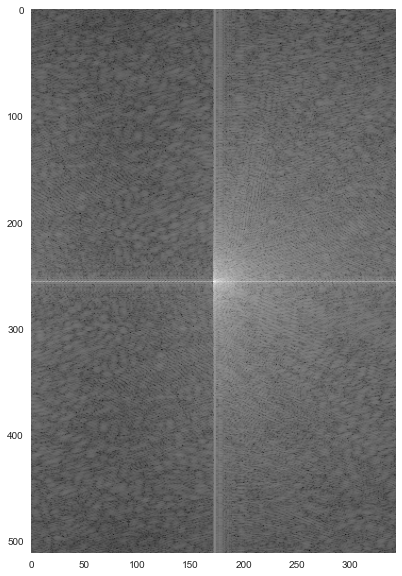

In [87]:
bell_fft = fft_2d(bell)
bell_fft_r = np.real(np.log(np.fft.fftshift(bell_fft)))
imshow(bell_fft_r)

### Speed Comparison

In [88]:
test_image = cv.imread(IMG_SRC+"kobe.png",0)

In [89]:
speeds_def = []
speeds_fft = []

img_sizes = [50,75,100,125]

for i in img_sizes:
    test_image = cv.resize(test_image, (i,i))

    s = time.time()
    dft_2d_opt(test_image)
    speeds_def += [(time.time() - s)*1000]

    s = time.time()
    fft_2d(test_image)
    speeds_fft += [(time.time() - s)*1000]

A
B
C
A
B
C
A
B
C
A
B
C


Text(0.5, 0, 'Image size')

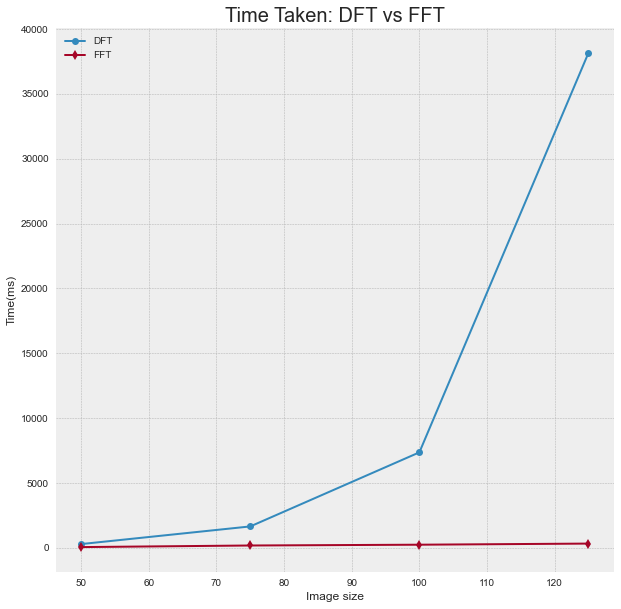

In [90]:
fig = plt.figure(figsize=(10,10))
plt.plot(img_sizes, speeds_def, marker="o", label="DFT")
plt.plot(img_sizes, speeds_fft, marker="d", label="FFT")
plt.legend()
plt.title("Time Taken: DFT vs FFT", fontsize=20)
plt.ylabel("Time(ms)")
plt.xlabel("Image size")

In [91]:
print("Default DFT Times")
[print(i,":",round(j,2),"ms") for i,j in zip(img_sizes, speeds_def)]
print("\nFFT Times")
[print(i,":",round(j,2),"ms") for i,j in zip(img_sizes, speeds_fft)]
pass

Default DFT Times
50 : 296.99 ms
75 : 1657.42 ms
100 : 7367.94 ms
125 : 38162.55 ms

FFT Times
50 : 64.06 ms
75 : 187.05 ms
100 : 248.18 ms
125 : 334.7 ms


<hr>

## 5.3: Inverse Fourier Transform (IFFT)

* This is calculated in a similar way to that shown above
* A quicker way to do so is by using the conjugate of the FFT, ie.
$$
IFFT = \frac{1}{N}*(FFT(x'))'
$$
where, 
    * $x'$ represents the complex conjugate of $x$

In [92]:
def ifft_1d(arr):
    
    return (1/len(arr))*np.conj(fft_1d(np.conj(arr)))[:len(arr)]

In [93]:
def ifft_2d(arr):

    h,w = arr.shape
    f = np.zeros((h,w), dtype=np.complex_)
    
    for i in range(h):
        f[i,:] = ifft_1d(arr[i,:])[:w]
    
    for i in range(w):
        f[:,i] = (ifft_1d(f[:,i]))[:h]
    
    return f
        

<hr>

## 5.4: Double Fourier Transform

In [94]:
catto = cv.imread(IMG_SRC+"cat.jpg", 0)
catto = cv.resize(catto, (256,256))

Text(0.5, 1.0, 'Chosen Image')

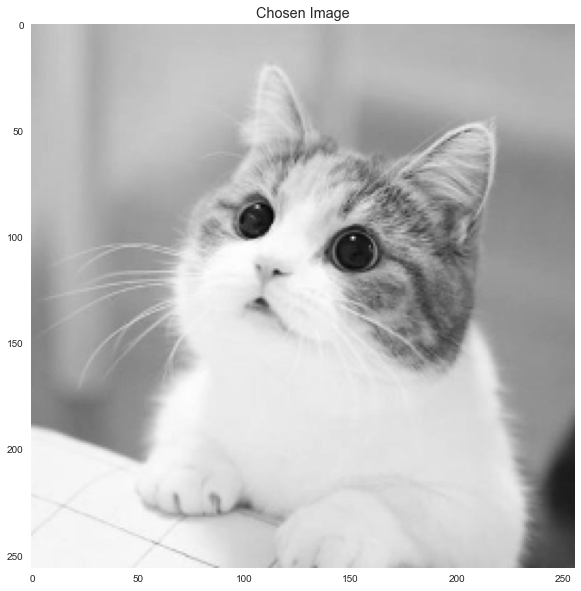

In [95]:
imshow(catto)
plt.title("Chosen Image")

### Finding the FFT

In [96]:
fft_catto = fft_2d(catto)

### Calculating the Second Fourier Transform

In [97]:
sf = (catto.shape[0]*catto.shape[1])

fft2_catto = fft_2d(fft_catto)/sf
fft2_catto_fixed = (fft_2d(np.conj(fft_catto)))/sf

### Plotting

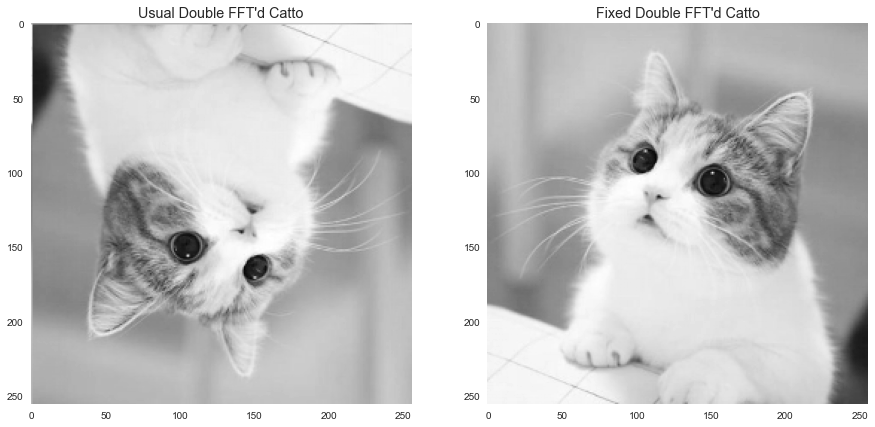

In [98]:
fig = plt.figure(figsize=(15,10))
ax1 = plt.subplot(121)
ax2 = plt.subplot(122)

ax1.set_title("Usual Double FFT'd Catto")
ax2.set_title("Fixed Double FFT'd Catto")

imshow(np.real(fft2_catto).astype('uint8'), ax=ax1)
imshow(np.real(fft2_catto_fixed).astype('uint8'), ax=ax2)

* In the above plot we notice that simply performing the Fourier Transform twice gives us a flipped image as the result
* This is due to the formula of FFT and IFFT differing only by the sign of the complex exponential (apart from the scaling factor)
* The FFT has a negative sign in the complex exponential, while the IFFT has a positive sign
* Thus to make the second FFT behave as the IFFT, we simply **take the complex conjugate of the input we pass to the second FFT**, which then acts like an IFFT operation

<hr>

# Q6)

## 6.1: Square Error

In [99]:
def avg_square_error(im1, im2):
    
    return np.mean((im1 - im2)**2)

def conv(img, kernel, absolute=False):
    k = kernel.shape[0]
    
    h,w = img.shape
    
    img_padded, h_new, w_new = pad_image(img, k)
    
    md = int(k*k/2)
    res = np.zeros((h,w)).astype('float32')
    
    for i in range(h):
        for j in range(w):
            res[i,j] = np.sum((img_padded[i:i+k,j:j+k]*kernel).ravel())
    
    if absolute:
        res = np.abs(res)
        
    return res/np.sum(kernel)

### Loading F and H

In [100]:
catto_256 = cv.imread(IMG_SRC+"cat2.jpg",0)
catto_256 = cv.resize(catto_256, (256,256))

doggo_256 = cv.imread(IMG_SRC+"dog.jpg",0)
doggo_256 = cv.resize(doggo_256, (256,256))

### Plotting the Input Images

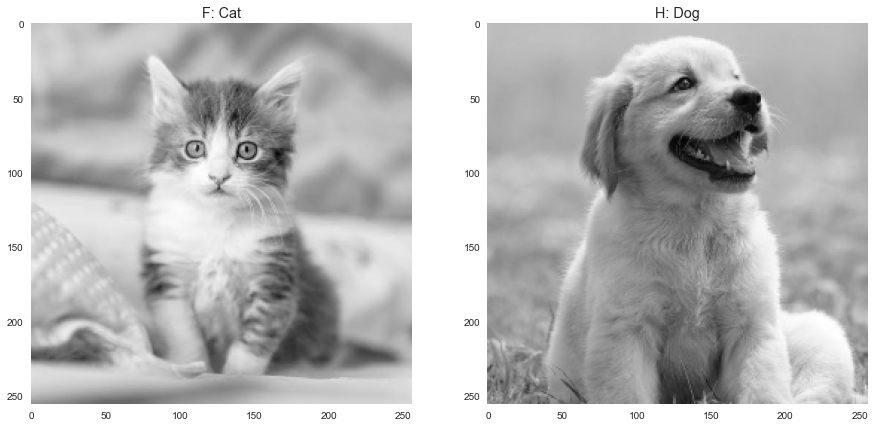

In [101]:
fig = plt.figure(figsize=(15,10))
ax1 = plt.subplot(121)
ax2 = plt.subplot(122)

ax1.set_title("F: Cat")
ax2.set_title("H: Dog")

imshow(catto_256, ax=ax1)
imshow(doggo_256, ax=ax2)

### Calculating the 2D FFT

In [102]:
F_256 = fft_2d(catto_256)
H_256 = fft_2d(doggo_256)

### Calculating the 2D IFFT of F*H

In [103]:
ift_FH_256 = ifft_2d(F_256*H_256)

### Calculating $F*H$

In [104]:
fconvh_256 = conv(catto_256, np.flip(doggo_256,1))

### Plotting

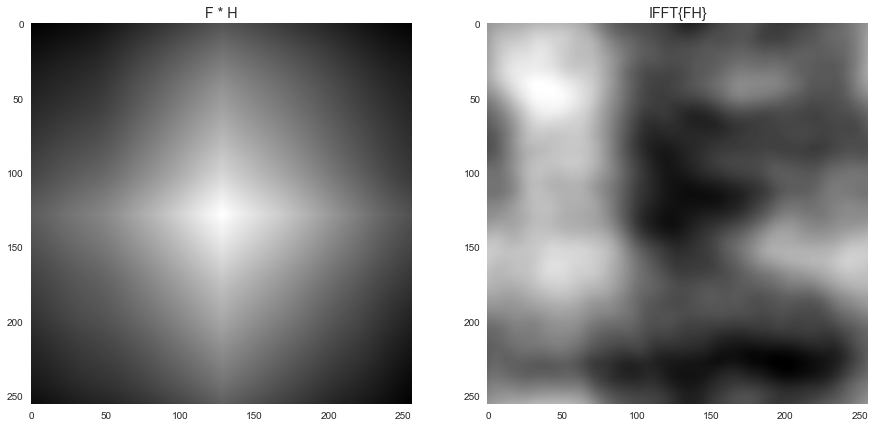

In [105]:
fig = plt.figure(figsize=(15,10))
ax1 = plt.subplot(121)
ax2 = plt.subplot(122)

ax1.set_title("F * H")
ax2.set_title("IFFT{FH}")

imshow(fconvh_256, ax=ax1)
imshow(np.real(ift_FH_256), ax=ax2)

### Printing the MSE

In [106]:
print("MSE =", avg_square_error(fconvh_256, ift_FH_256))

MSE = (3.302881969572103e+18+3.500183134123244j)


<hr>

## 6.2: Various Sized Padding

### Padding to 511

In [107]:
doggo_511 = np.zeros((511,511))
doggo_511[:256,:256] = doggo_256

catto_511 = np.zeros((511,511))
catto_511[:256,:256] = catto_256

### Calculating the FFT, ie. F & H

In [108]:
F_511 = fft_2d(catto_511)
H_511 = fft_2d(doggo_511)

### Calculating IFFT of F*H

In [109]:
ift_FH_511 = ifft_2d(F_511*H_511)

### Calculating $F*H$

In [110]:
fconvh_511 = conv(catto_511, doggo_511)

### Plotting

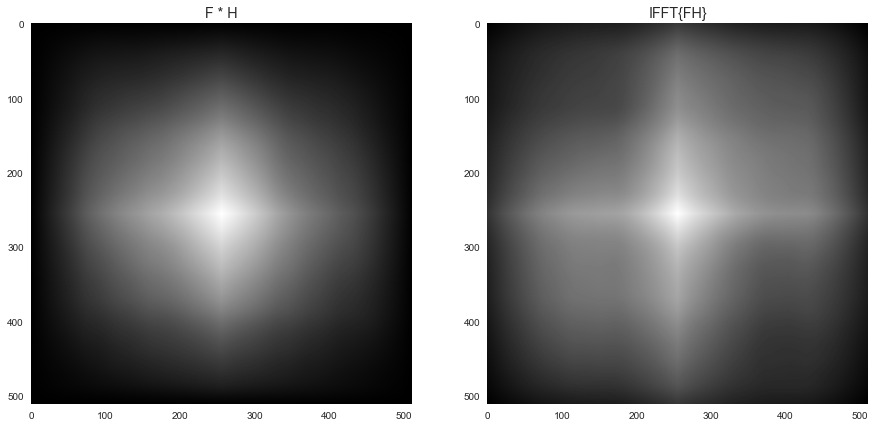

In [111]:
fig = plt.figure(figsize=(15,10))
ax1 = plt.subplot(121)
ax2 = plt.subplot(122)

ax1.set_title("F * H")
ax2.set_title("IFFT{FH}")

imshow(fconvh_511, ax=ax1)
imshow(np.real(ift_FH_511), ax=ax2)

### Printing MSE

In [112]:
print("MSE =", avg_square_error(fconvh_511, ift_FH_511))

MSE = (2.1175891838919987e+17+6890874485810.749j)


* We notice the MSE has reduced

### Choosing a 64x64 Image and Padding

In [113]:
pikachu_64 = cv.imread(IMG_SRC+"pikachu.png", 0)

pikachu_128 = np.zeros((128,128)).astype('uint8')
pikachu_128[:64,:64] = pikachu_64

pikachu_256 = np.zeros((256,256)).astype('uint8')
pikachu_256[:64,:64] = pikachu_64

pikachu_512 = np.zeros((512,512)).astype('uint8')
pikachu_512[:64,:64] = pikachu_64

### Plotting the Input Images

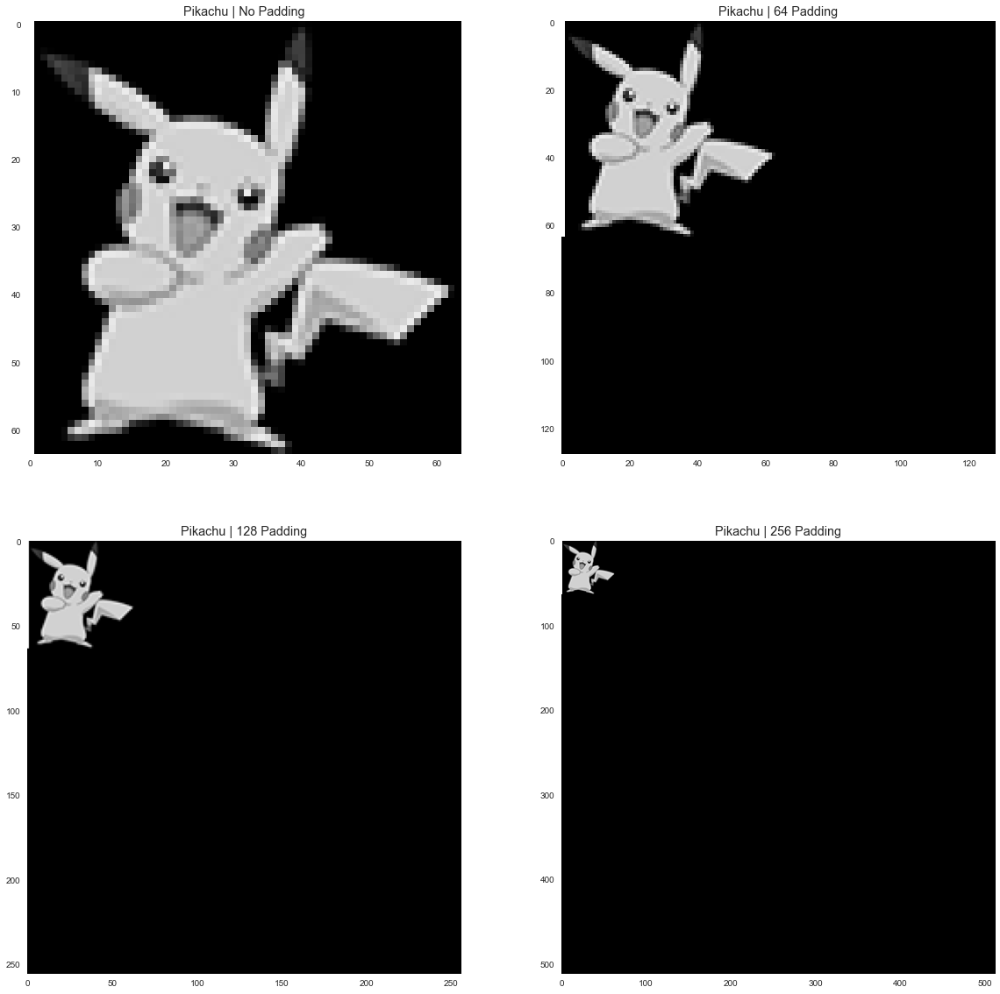

In [114]:
fig = plt.figure(figsize=(20,20))
ax1 = plt.subplot(221)
ax2 = plt.subplot(222)
ax3 = plt.subplot(223)
ax4 = plt.subplot(224)

ax1.set_title("Pikachu | No Padding")
ax2.set_title("Pikachu | 64 Padding")
ax3.set_title("Pikachu | 128 Padding")
ax4.set_title("Pikachu | 256 Padding")

imshow(pikachu_64, ax=ax1)
imshow(pikachu_128, ax=ax2)
imshow(pikachu_256, ax=ax3)
imshow(pikachu_512, ax=ax4)

### Calculating the FFTs

In [115]:
fft_pik_64 = fft_2d(pikachu_64)
fft_pik_128 = fft_2d(pikachu_128)
fft_pik_256 = fft_2d(pikachu_256)
fft_pik_512 = fft_2d(pikachu_512)

### Plotting the FFTs

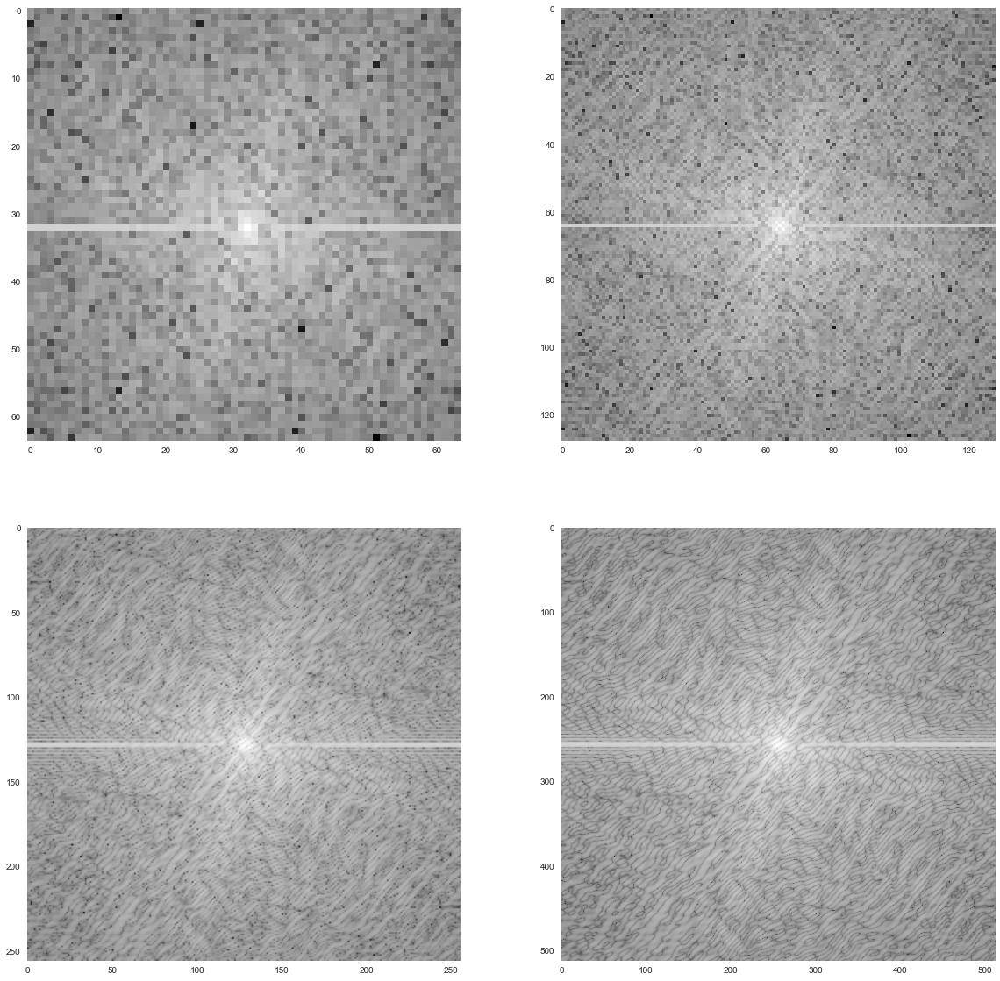

In [116]:
fig = plt.figure(figsize=(20,20))
ax1 = plt.subplot(221)
ax2 = plt.subplot(222)
ax3 = plt.subplot(223)
ax4 = plt.subplot(224)

f_64 = np.log(np.abs(np.fft.fftshift(np.real(fft_pik_64))))
f_128 = np.log(np.abs(np.fft.fftshift(np.real(fft_pik_128))))
f_256 = np.log(np.abs(np.fft.fftshift(np.real(fft_pik_256))))
f_512 = np.log(np.abs(np.fft.fftshift(np.real(fft_pik_512))))

imshow(f_64, ax=ax1)
imshow(f_128, ax=ax2)
imshow(f_256, ax=ax3)
imshow(f_512, ax=ax4)

* We notice that the FFTs are simply scaled versions of each other, with the phase changing due to change in $M$ and $N$
* We can attribute this to the fact that in the FFT equation, $f[x,y] = 0$ wherever we have performed padding, and thus the summation will only change due to $M$ and $N$ values
* The only value that changes is that of the exponential term, where we divide with progressively larger versions of $M$ and $N$

<hr>

# Q7)

### Helper Functions for the Question

In [117]:
def disp_fft(fft, shift=False, ax1=None, ax2=None):
    
    if shift:
        fft = np.log((np.fft.fftshift(fft)))
    else:
        fft = np.log(((fft)))
    
    if ax1 and ax2:
        imshow(np.real(fft), ax=ax1)
        imshow(np.imag(fft), ax=ax2)
    else:
        
        fig = plt.figure(figsize=(15,15))
        ax1 = plt.subplot(121)
        ax2 = plt.subplot(122)
        
        ax1.set_title("Real Part")
        ax2.set_title("Imaginary Part")
        
        imshow(np.real(fft), ax=ax1)
        imshow(np.imag(fft), ax=ax2)
        
def pad_image_complex(img, k):
    
    h,w = img.shape
    img_padded = np.zeros((h + (k//2)*2, w + (k//2)*2)).astype('complex')
    h_new, w_new = img_padded.shape
    
    img_padded[k//2:h_new-k//2,k//2:w_new-k//2] = img
    
    return img_padded, h_new, w_new
        
def gaussian_lowpass(img, sigma):
    
    h,w = img.shape
    k = int(3*sigma)
    
    g1 = np.array([[(i)**2 + (j)**2 for j in range(-k//2+1, k//2+1)] for i in range(-k//2+1, k//2+1)])
    g1 = (1/(2*np.pi*(sigma**2)))*np.exp(-g1/(2*(sigma**2)))
    
    img_padded, h_new, w_new = pad_image_complex(img, k)
    
    res = np.zeros(img.shape).astype("complex")
    
    for i in range(h):
        for j in range(w):
            
            res[i,j] = np.sum(g1*img_padded[i:i+k, j:j+k])
    return res
    

In [118]:
noisy_lena = cv.imread(IMG_SRC+"noisy_lena.png",0)

### Creating a Median Filtered Copy

In [119]:
nl_med = median_filter_optimized(noisy_lena, 2)
nl = noisy_lena.copy()

### Calculating the FFTs and Displaying them

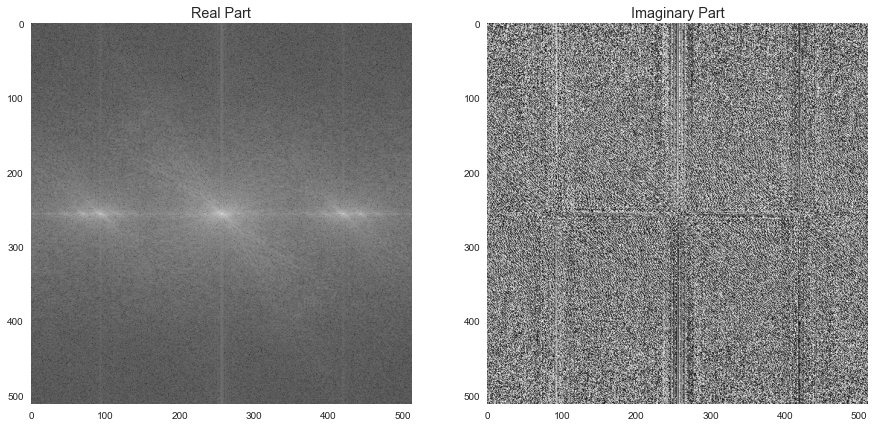

In [120]:
F_nl = fft_2d(nl)
F_med = fft_2d(nl_med)
disp_fft(F_nl, 1)

### Manipulating the Fourier Transform Using a Combination of Notch and Gaussian Low Pass Filter

/Users/ahish/lib/python3.6/site-packages/ipykernel_launcher.py:6: RuntimeWarning: divide by zero encountered in log
  


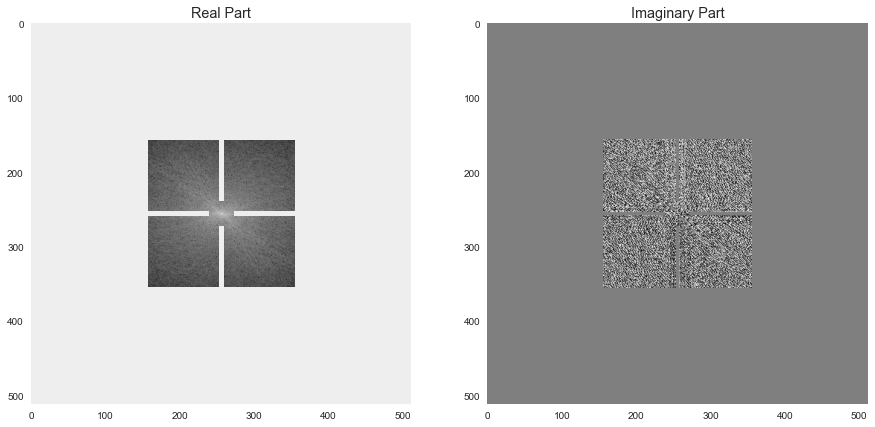

In [121]:
F = F_nl.copy()

n = 512
k = n//2
f = 45

F = np.fft.fftshift(F)

s=2
p = 17
p2 = 80

# removing noisy frequencies
F[k-s:k+s, :k-p] = 0
F[k-s:k+s, k+p:] = 0
F[:,:k-100] = 0
F[:,k+100:] = 0
F[:k-100,:] = 0
F[k+100:,:] = 0

# creating the plus mask
F[:k-p, k-s:k+s] = 0
F[k+p:, k-s:k+s] = 0

# multiplying by a low pass gaussian
k = F.shape[0]
sigma = 80
g1 = np.array([[(i)**2 + (j)**2 for j in range(-k//2+1, k//2+1)] for i in range(-k//2+1, k//2+1)])
g1 = (1/np.sqrt(2*np.pi*(sigma**2)))*np.exp(-g1/(2*(sigma**2)))

F *= g1

disp_fft(F, 0)

F = np.fft.fftshift(F)

### Reconstructing from the Manipulated FFT shown above

In [122]:
rec_im1 = np.real(ifft_2d(F)) #IFFT
rec_im1 = rec_im1*255/rec_im1.max() #scaling
rec_im1 = bilateral_filter(rec_im1, 5,5,3) #bilateral filter

### Using Only a Notch Filter 

/Users/ahish/lib/python3.6/site-packages/ipykernel_launcher.py:6: RuntimeWarning: divide by zero encountered in log
  


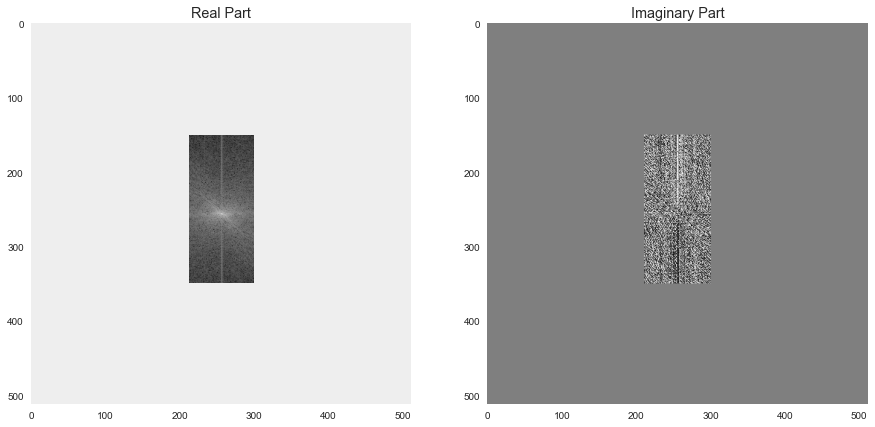

In [123]:
F2 = F_med.copy()

n = 512
k = n//2
f = 45

F2 = np.fft.fftshift(F2)

# creating mask
F2[:,:n//2-f] = 0.0
F2[:,n//2+f:] = 0.0
F2[:150,:] = 0.0
F2[350:,:] = 0.0

disp_fft(F2, 0)
F2 = np.fft.fftshift(F2)

### Reconstructing from the Second FFT

In [124]:
rec_im2 = np.real(ifft_2d(F2))
rec_im2 = rec_im2*255/rec_im2.max()
rec_im2 = bilateral_filter(rec_im2, 5,5,3)

### Combining the Results

In [125]:
# combining the two results
beta = 0.5
rec_final = beta*rec_im1 + (1-beta)*rec_im2

### Displaying the Denoised Lena

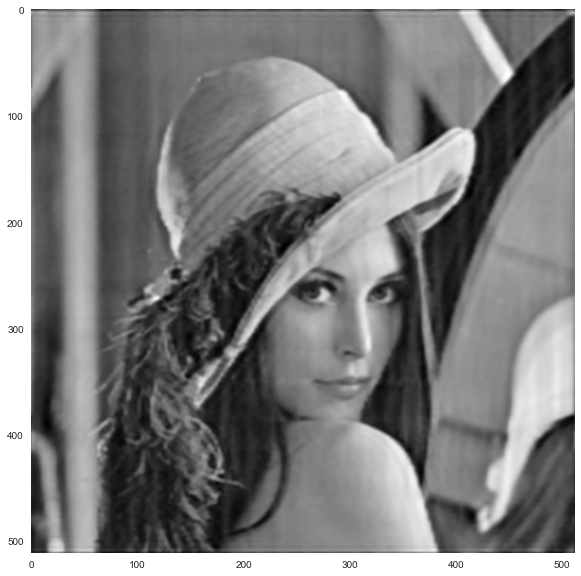

In [126]:
imshow(rec_final)

<hr>